In [7]:
import os
import pandas as pd

# data 폴더 경로
folder_path = "./data"

# 폴더 내 모든 xlsx 파일 목록 가져오기
file_list = [f for f in os.listdir(folder_path) if f.endswith('.xlsx')]

# 모든 엑셀 파일을 읽어와 병합
df_list = [pd.read_excel(os.path.join(folder_path, file)) for file in file_list]

# 행 병합
merged_df = pd.concat(df_list, ignore_index=True)
unique_items = merged_df['품목'].unique()
print(unique_items)
# 결과 확인
merged_df


['녹두' '호박' '고추' '깐마늘(국산)' '부추' '브로콜리' '감귤' '팥' '풋고추' '바나나' '생강' '땅콩' '딸기'
 '참깨' '갓' '건포도' '참외' '시금치' '파' '수박' '갈치' '느타리버섯' '아보카도' '양파' '깻잎' '호두'
 '열무' '파프리카' '건블루베리' '상추' '배추' '방울토마토' '콩' '체리' '복숭아' '배' '팽이버섯' '오렌지'
 '멜론' '아몬드' '망고' '포도' '건고추' '양배추' '토마토' '단감' '자몽' '피망' '참다래' '가지' '사과'
 '미나리' '피마늘' '새송이버섯' '메밀' '레몬' '오이' '콩나물' '파인애플' '당근' '무' '감자' '고구마']


,DATE,품목,품종,거래단위,등급,평균가격,전년,평년
0,202502중순,녹두,국산,40kg,상품,562500,524125,583722.333333
1,202502중순,녹두,국산,40kg,중품,476500,0,0
2,202502중순,녹두,녹두(전체),40kg,상품,-,-,-
3,202502중순,녹두,녹두(전체),40kg,중품,-,-,-
4,202502중순,녹두,수입,40kg,중품,215000,229600,225172.333333
...,...,...,...,...,...,...,...,...
162506,202501중순,고구마,밤,10kg,중품,26987,28900,26767.666667
162507,202501하순,고구마,고구마(전체),10kg,상품,-,-,-
162508,202501하순,고구마,고구마(전체),10kg,중품,-,-,-
162509,202501하순,고구마,밤,10kg,상품,34592,34033,31668


In [8]:
import numpy as np

# '0'과 '-'를 NaN으로 변환
merged_df.replace(['0',0, '-'], np.nan, inplace=True)

# 결과 확인
merged_df


C:\Users\user\AppData\Local\Temp\ipykernel_11560\2024386886.py:4: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  merged_df.replace(['0',0, '-'], np.nan, inplace=True)


,DATE,품목,품종,거래단위,등급,평균가격,전년,평년
0,202502중순,녹두,국산,40kg,상품,562500.0,524125.0,583722.333333
1,202502중순,녹두,국산,40kg,중품,476500.0,NaN,NaN
2,202502중순,녹두,녹두(전체),40kg,상품,NaN,NaN,NaN
3,202502중순,녹두,녹두(전체),40kg,중품,NaN,NaN,NaN
4,202502중순,녹두,수입,40kg,중품,215000.0,229600.0,225172.333333
...,...,...,...,...,...,...,...,...
162506,202501중순,고구마,밤,10kg,중품,26987.0,28900.0,26767.666667
162507,202501하순,고구마,고구마(전체),10kg,상품,NaN,NaN,NaN
162508,202501하순,고구마,고구마(전체),10kg,중품,NaN,NaN,NaN
162509,202501하순,고구마,밤,10kg,상품,34592.0,34033.0,31668.000000


In [9]:
# '평균가격', '전년', '평년' 열이 모두 NaN인 행 삭제
merged_df.dropna(subset=['평균가격', '전년', '평년'], how='all', inplace=True)
merged_df =merged_df[~merged_df['DATE'].astype(str).str.startswith('200')]
'''
merged_df =merged_df[~merged_df['DATE'].astype(str).str.startswith('2010')]
merged_df =merged_df[~merged_df['DATE'].astype(str).str.startswith('2011')]
merged_df =merged_df[~merged_df['DATE'].astype(str).str.startswith('2012')]
merged_df =merged_df[~merged_df['DATE'].astype(str).str.startswith('2013')]
merged_df =merged_df[~merged_df['DATE'].astype(str).str.startswith('2014')]'''

# 결과 확인
merged_df


,DATE,품목,품종,거래단위,등급,평균가격,전년,평년
0,202502중순,녹두,국산,40kg,상품,562500.0,524125.0,583722.333333
1,202502중순,녹두,국산,40kg,중품,476500.0,NaN,NaN
4,202502중순,녹두,수입,40kg,중품,215000.0,229600.0,225172.333333
5,202502상순,녹두,국산,40kg,상품,560800.0,521417.0,584285.000000
6,202502상순,녹두,국산,40kg,중품,476500.0,NaN,NaN
...,...,...,...,...,...,...,...,...
162502,202501상순,고구마,밤,10kg,중품,26691.0,27869.0,26935.333333
162505,202501중순,고구마,밤,10kg,상품,34593.0,35077.0,32180.000000
162506,202501중순,고구마,밤,10kg,중품,26987.0,28900.0,26767.666667
162509,202501하순,고구마,밤,10kg,상품,34592.0,34033.0,31668.000000


In [10]:
unique_counts = merged_df.nunique()
print(unique_counts)


DATE      545
품목         61
품종        147
거래단위       22
등급          5
평균가격    24454
전년      22716
평년      32432
dtype: int64


In [11]:
import pandas as pd

# 그룹화하여 count, 첫 DATE, 마지막 DATE 생성
grouped_df = merged_df.groupby(['품목', '품종', '거래단위', '등급'], as_index=False).agg(
    count=('DATE', 'count'),  # 해당 그룹의 행 개수
    첫_date=('DATE', 'min'),  # DATE 문자열 기준 첫 번째 값
    마지막_date=('DATE', 'max')  # DATE 문자열 기준 마지막 값
)

# 결과 확인
grouped_df

,품목,품종,거래단위,등급,count,첫_date,마지막_date
0,가지,가지,10개,무농약,13,201509상순,202405중순
1,가지,가지,10개,유기농,8,201509상순,202310하순
2,감귤,감귤,10kg,상품,127,201001상순,201801상순
3,감귤,감귤,10kg,중품,127,201001상순,201801상순
4,감귤,감귤(전체),5kg,M과,1,202411하순,202411하순
...,...,...,...,...,...,...,...
302,호박,애호박,1개,중품,545,201001상순,202502중순
303,호박,쥬키니,1개,상품,545,201001상순,202502중순
304,호박,쥬키니,1개,중품,343,201001상순,201907상순
305,호박,호박(전체),1개,상품,1,202411하순,202411하순


In [12]:
import matplotlib.pyplot as plt
from matplotlib import font_manager, rc

# Windows의 경우 (Malgun Gothic)
font_path = "C:/Windows/Fonts/malgun.ttf"

# Mac의 경우 예: /Library/Fonts/AppleGothic.ttf
# Linux의 경우 예: /usr/share/fonts/truetype/nanum/NanumGothic.ttf

font_name = font_manager.FontProperties(fname=font_path).get_name()
rc('font', family=font_name)

# 마이너스 깨짐 방지
plt.rcParams['axes.unicode_minus'] = False


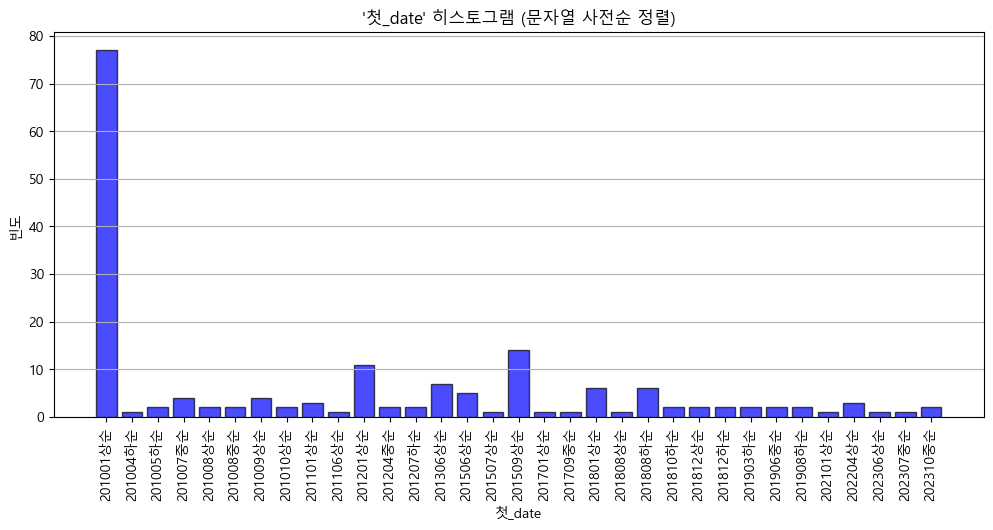

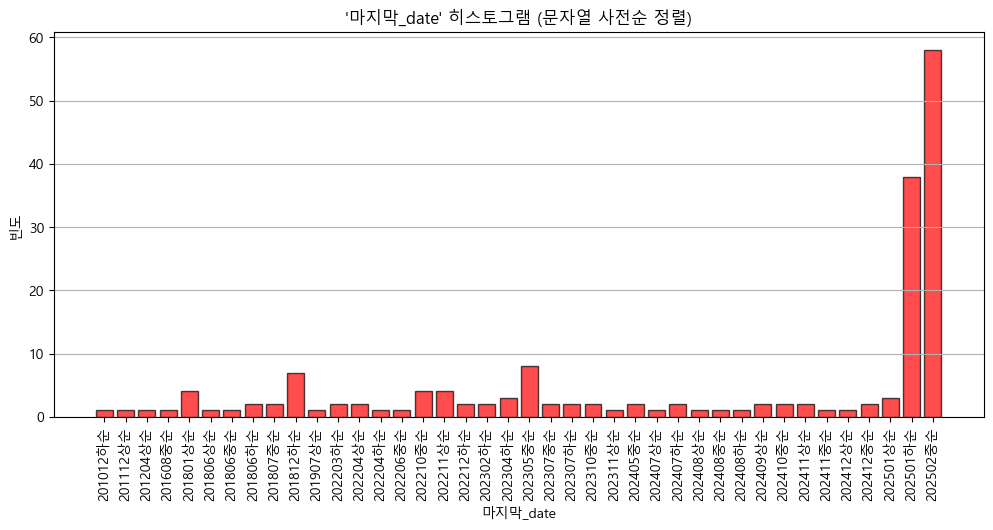

In [13]:
import matplotlib.pyplot as plt
import pandas as pd
grouped_df = grouped_df[grouped_df['count'] >= 36]
# '첫_date'와 '마지막_date'의 고유한 날짜를 문자열 기준으로 정렬
sorted_dates_첫 = sorted(grouped_df['첫_date'].astype(str).unique())
sorted_dates_마지막 = sorted(grouped_df['마지막_date'].astype(str).unique())

# 첫_date 빈도수 계산
첫_date_counts = grouped_df['첫_date'].astype(str).value_counts().reindex(sorted_dates_첫, fill_value=0)

# 마지막_date 빈도수 계산
마지막_date_counts = grouped_df['마지막_date'].astype(str).value_counts().reindex(sorted_dates_마지막, fill_value=0)

# 첫_date 히스토그램 (사전순 정렬)
plt.figure(figsize=(12, 5))
plt.bar(첫_date_counts.index, 첫_date_counts.values, color='blue', alpha=0.7, edgecolor='black')
plt.xticks(rotation=90)
plt.xlabel('첫_date')
plt.ylabel('빈도')
plt.title("'첫_date' 히스토그램 (문자열 사전순 정렬)")
plt.grid(axis='y')
plt.show()

# 마지막_date 히스토그램 (사전순 정렬)
plt.figure(figsize=(12, 5))
plt.bar(마지막_date_counts.index, 마지막_date_counts.values, color='red', alpha=0.7, edgecolor='black')
plt.xticks(rotation=90)
plt.xlabel('마지막_date')
plt.ylabel('빈도')
plt.title("'마지막_date' 히스토그램 (문자열 사전순 정렬)")
plt.grid(axis='y')
plt.show()


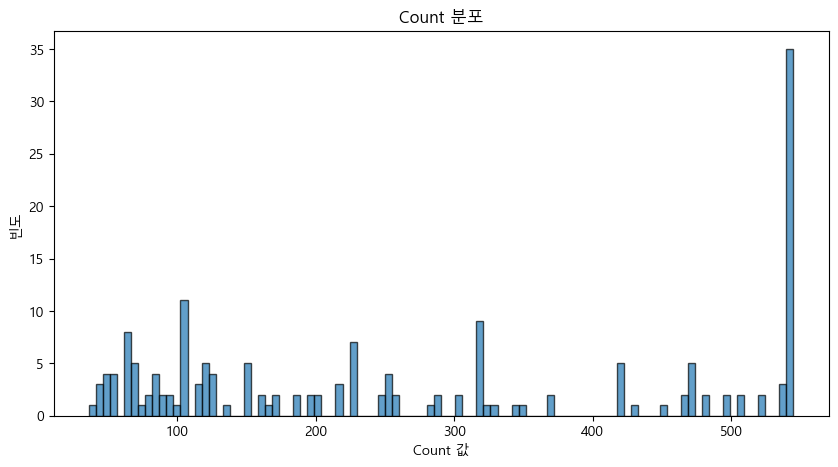

In [14]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 5))
plt.hist(grouped_df['count'], bins=100, edgecolor='black', alpha=0.7)
plt.xlabel('Count 값')
plt.ylabel('빈도')
plt.title('Count 분포')
plt.show()


In [15]:
grouped_df = grouped_df[grouped_df['count'] >= 72]
grouped_df = grouped_df[~grouped_df['마지막_date'].astype(str).str.startswith('201')]
#grouped_df = grouped_df[grouped_df['등급'] != '중품']


grouped_df = grouped_df.reset_index(drop=True)
unique_counts = grouped_df.nunique()
print(unique_counts)

품목          53
품종          63
거래단위        19
등급           5
count       59
첫_date      23
마지막_date    24
dtype: int64


In [16]:
filtered_df = merged_df.merge(grouped_df[['품목', '품종', '거래단위', '등급']].drop_duplicates(),
                              on=['품목', '품종', '거래단위', '등급'],
                              how='inner')
unique_counts = filtered_df.nunique()
print(unique_counts)

DATE      545
품목         53
품종         63
거래단위       19
등급          5
평균가격    22395
전년      20853
평년      29067
dtype: int64


In [17]:
filtered_df


,DATE,품목,품종,거래단위,등급,평균가격,전년,평년
0,202502중순,녹두,국산,40kg,상품,562500.0,524125.0,583722.333333
1,202502중순,녹두,국산,40kg,중품,476500.0,NaN,NaN
2,202502중순,녹두,수입,40kg,중품,215000.0,229600.0,225172.333333
3,202502상순,녹두,국산,40kg,상품,560800.0,521417.0,584285.000000
4,202502상순,녹두,국산,40kg,중품,476500.0,NaN,NaN
...,...,...,...,...,...,...,...,...
43796,202501상순,고구마,밤,10kg,중품,26691.0,27869.0,26935.333333
43797,202501중순,고구마,밤,10kg,상품,34593.0,35077.0,32180.000000
43798,202501중순,고구마,밤,10kg,중품,26987.0,28900.0,26767.666667
43799,202501하순,고구마,밤,10kg,상품,34592.0,34033.0,31668.000000


1 감귤 노지 5kg M과
  - 기간 (유효 데이터 기준): 201810하순 ~ 202501하순
  - '평균가격' 결측값 개수: 128
  - 기간 내 전체 날짜 수: 226
  - 결측 비율: 56.64%



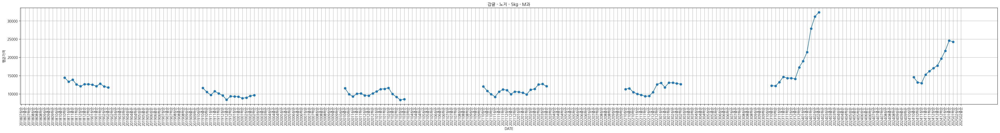

2 감자 대지마 20kg 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202404상순
  - '평균가격' 결측값 개수: 407
  - 기간 내 전체 날짜 수: 514
  - 결측 비율: 79.18%



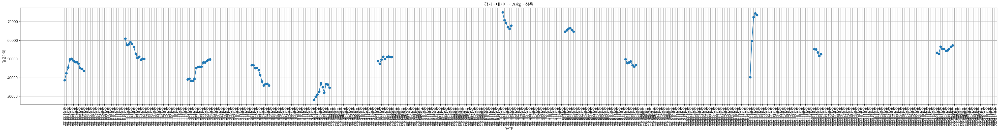

3 감자 대지마 20kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202404상순
  - '평균가격' 결측값 개수: 407
  - 기간 내 전체 날짜 수: 514
  - 결측 비율: 79.18%



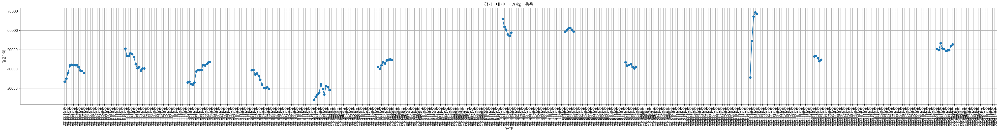

4 감자 수미 20kg 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202305중순
  - '평균가격' 결측값 개수: 1
  - 기간 내 전체 날짜 수: 482
  - 결측 비율: 0.21%



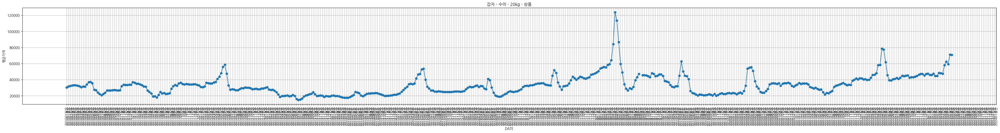

5 감자 수미 20kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202305중순
  - '평균가격' 결측값 개수: 1
  - 기간 내 전체 날짜 수: 482
  - 결측 비율: 0.21%



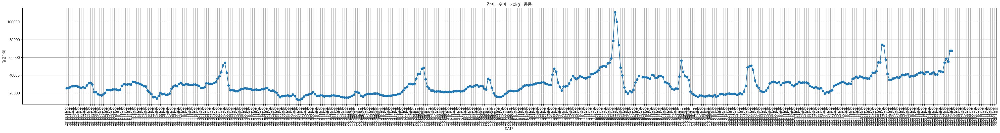

6 갓 갓 1kg 상품
  - 기간 (유효 데이터 기준): 201507상순 ~ 202501상순
  - '평균가격' 결측값 개수: 157
  - 기간 내 전체 날짜 수: 343
  - 결측 비율: 45.77%



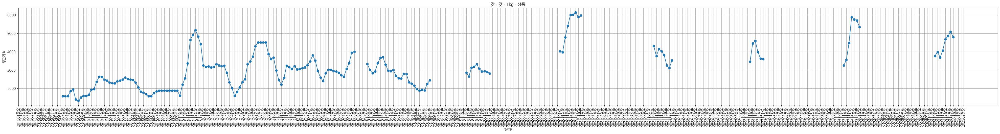

7 건고추 양건 30kg 상품
  - 기간 (유효 데이터 기준): 201812하순 ~ 202305중순
  - '평균가격' 결측값 개수: 1
  - 기간 내 전체 날짜 수: 159
  - 결측 비율: 0.63%



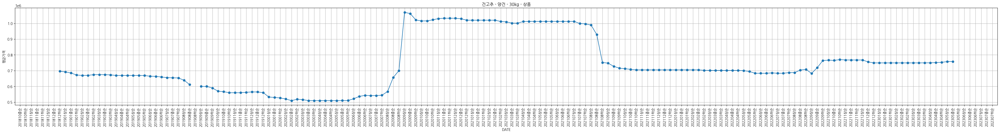

8 건고추 양건 30kg 중품
  - 기간 (유효 데이터 기준): 201812하순 ~ 202305중순
  - '평균가격' 결측값 개수: 1
  - 기간 내 전체 날짜 수: 159
  - 결측 비율: 0.63%



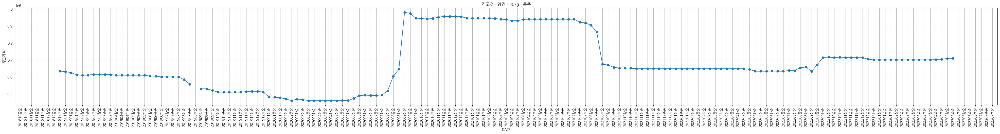

9 건고추 화건 30kg 상품
  - 기간 (유효 데이터 기준): 201812하순 ~ 202501하순
  - '평균가격' 결측값 개수: 1
  - 기간 내 전체 날짜 수: 220
  - 결측 비율: 0.45%



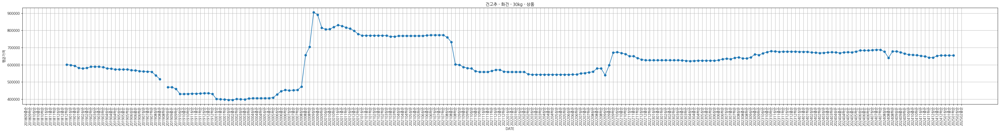

10 건고추 화건 30kg 중품
  - 기간 (유효 데이터 기준): 201812하순 ~ 202501하순
  - '평균가격' 결측값 개수: 1
  - 기간 내 전체 날짜 수: 220
  - 결측 비율: 0.45%



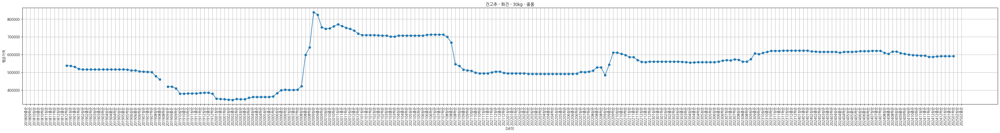

11 건블루베리 수입 100g 중품
  - 기간 (유효 데이터 기준): 201306상순 ~ 202203하순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 318
  - 결측 비율: 0.00%



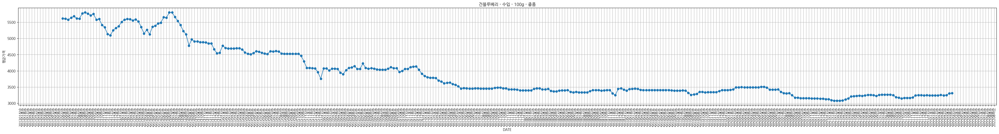

12 건포도 수입 100g 중품
  - 기간 (유효 데이터 기준): 201306상순 ~ 202203하순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 318
  - 결측 비율: 0.00%



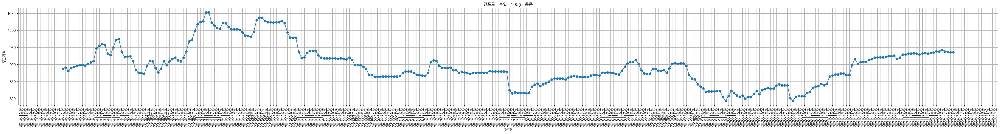

13 고구마 밤 10kg 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202501하순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 543
  - 결측 비율: 0.00%



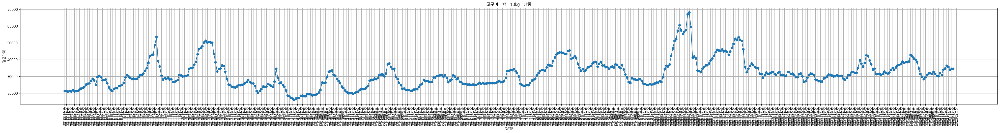

14 고구마 밤 10kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202501하순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 543
  - 결측 비율: 0.00%



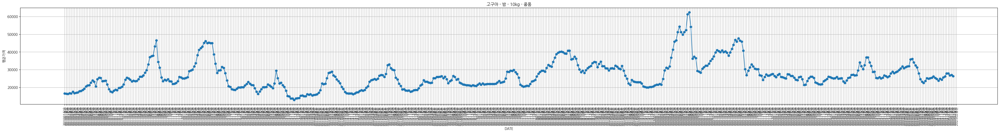

15 깐마늘(국산) 깐마늘(남도) 20kg 상품
  - 기간 (유효 데이터 기준): 201801상순 ~ 202501하순
  - '평균가격' 결측값 개수: 2
  - 기간 내 전체 날짜 수: 255
  - 결측 비율: 0.78%



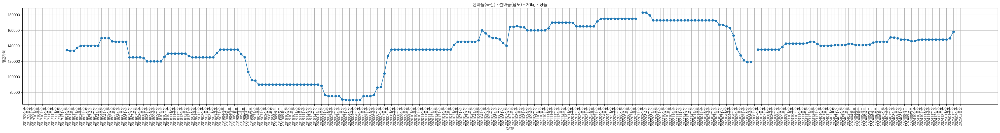

16 깐마늘(국산) 깐마늘(남도) 20kg 중품
  - 기간 (유효 데이터 기준): 201801상순 ~ 202501하순
  - '평균가격' 결측값 개수: 2
  - 기간 내 전체 날짜 수: 255
  - 결측 비율: 0.78%



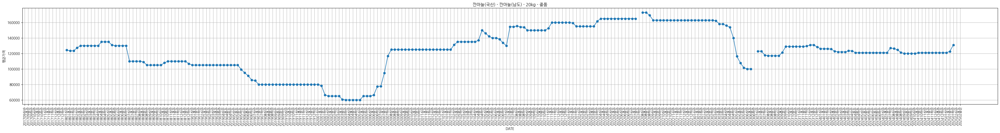

17 깐마늘(국산) 깐마늘(대서) 20kg 상품
  - 기간 (유효 데이터 기준): 201801상순 ~ 202501하순
  - '평균가격' 결측값 개수: 1
  - 기간 내 전체 날짜 수: 255
  - 결측 비율: 0.39%



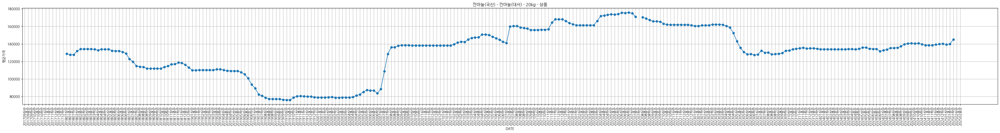

18 깐마늘(국산) 깐마늘(대서) 20kg 중품
  - 기간 (유효 데이터 기준): 201801상순 ~ 202501하순
  - '평균가격' 결측값 개수: 1
  - 기간 내 전체 날짜 수: 255
  - 결측 비율: 0.39%



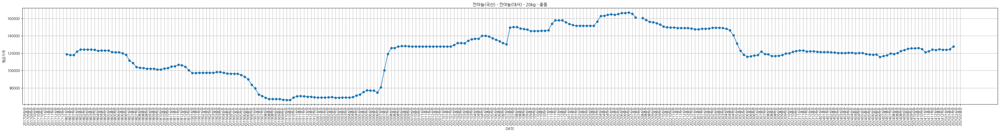

19 깻잎 깻잎 100g 무농약
  - 기간 (유효 데이터 기준): 201001상순 ~ 202003하순
  - '평균가격' 결측값 개수: 8
  - 기간 내 전체 날짜 수: 369
  - 결측 비율: 2.17%



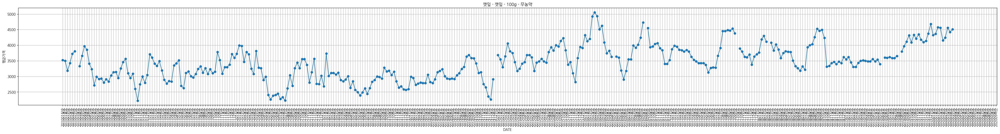

20 깻잎 깻잎 100g 유기농
  - 기간 (유효 데이터 기준): 201001상순 ~ 202003하순
  - '평균가격' 결측값 개수: 8
  - 기간 내 전체 날짜 수: 369
  - 결측 비율: 2.17%



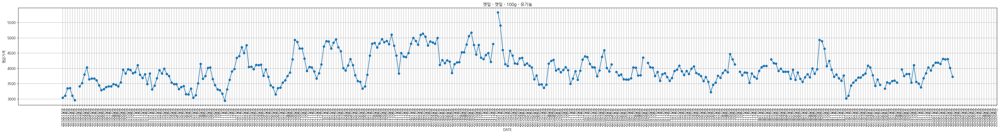

21 녹두 국산 40kg 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



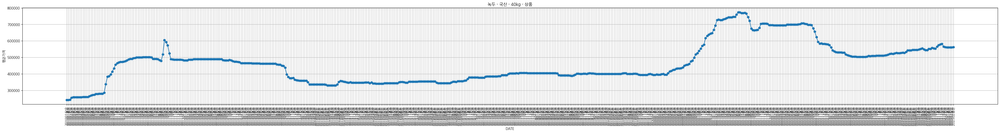

22 녹두 국산 40kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 94
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 17.25%



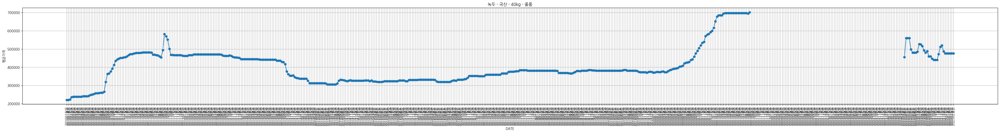

23 녹두 수입 40kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



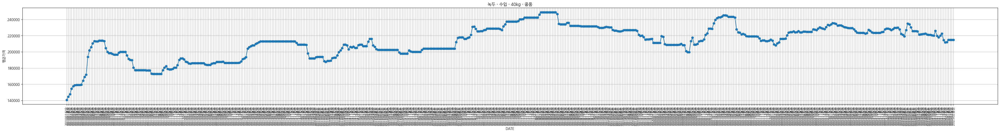

24 느타리버섯 느타리버섯 2kg 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



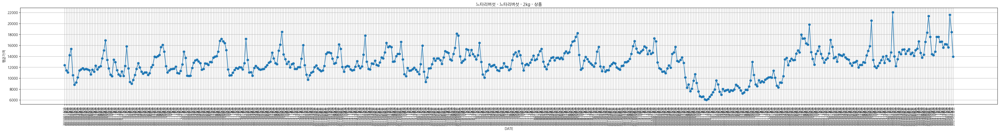

25 느타리버섯 느타리버섯 2kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



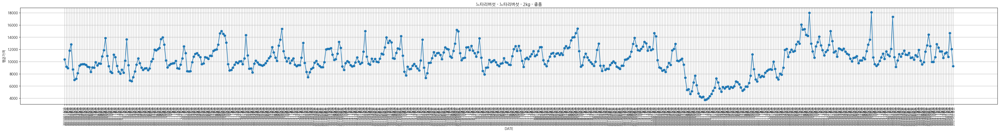

26 느타리버섯 애느타리버섯 2kg 상품
  - 기간 (유효 데이터 기준): 201801상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 257
  - 결측 비율: 0.00%



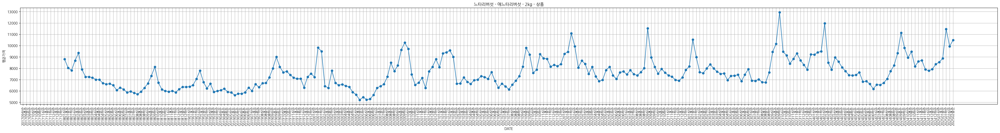

27 느타리버섯 애느타리버섯 2kg 중품
  - 기간 (유효 데이터 기준): 201801상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 257
  - 결측 비율: 0.00%



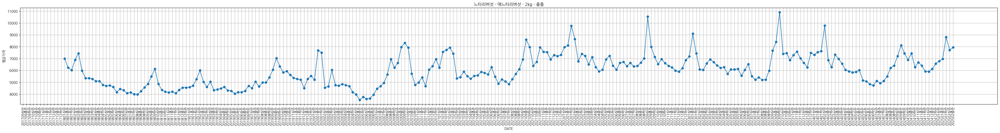

28 단감 단감 10kg 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202501하순
  - '평균가격' 결측값 개수: 296
  - 기간 내 전체 날짜 수: 543
  - 결측 비율: 54.51%



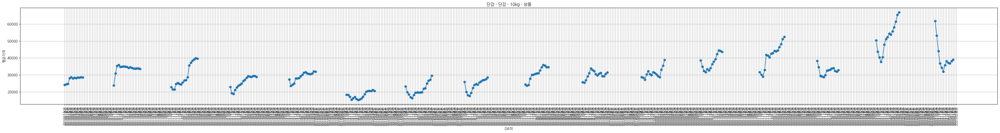

29 단감 단감 10kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202501하순
  - '평균가격' 결측값 개수: 295
  - 기간 내 전체 날짜 수: 543
  - 결측 비율: 54.33%



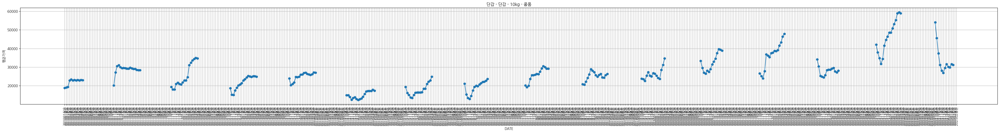

30 당근 무세척 20kg 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202501하순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 543
  - 결측 비율: 0.00%



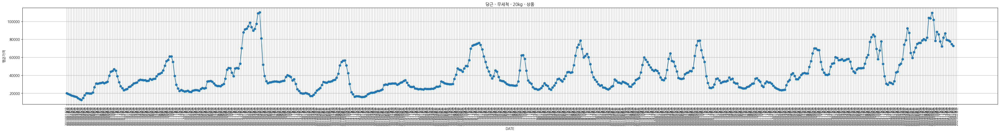

31 당근 무세척 20kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202501하순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 543
  - 결측 비율: 0.00%



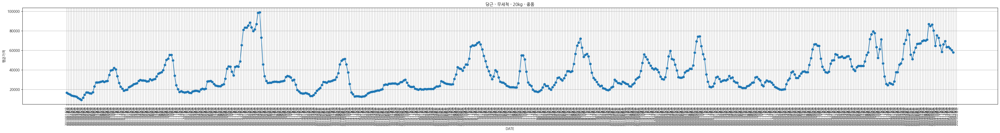

32 당근 세척(수입) 10kg 중품
  - 기간 (유효 데이터 기준): 201101상순 ~ 202501하순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 507
  - 결측 비율: 0.00%



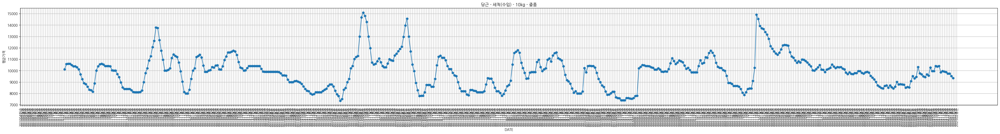

33 딸기 딸기 2kg 상품
  - 기간 (유효 데이터 기준): 201201상순 ~ 202405상순
  - '평균가격' 결측값 개수: 233
  - 기간 내 전체 날짜 수: 445
  - 결측 비율: 52.36%



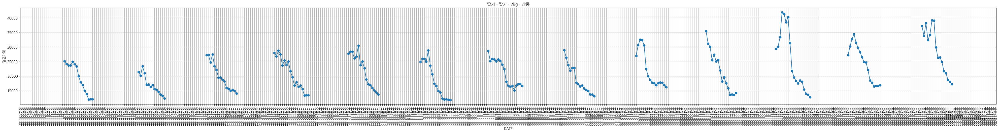

34 딸기 딸기 2kg 중품
  - 기간 (유효 데이터 기준): 201201상순 ~ 202405상순
  - '평균가격' 결측값 개수: 233
  - 기간 내 전체 날짜 수: 445
  - 결측 비율: 52.36%



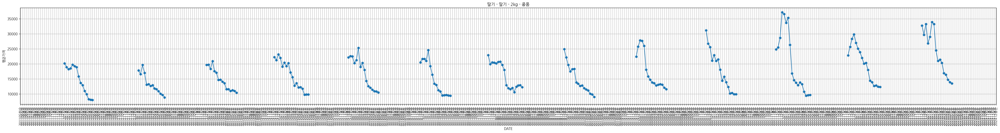

35 땅콩 국산 30kg 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



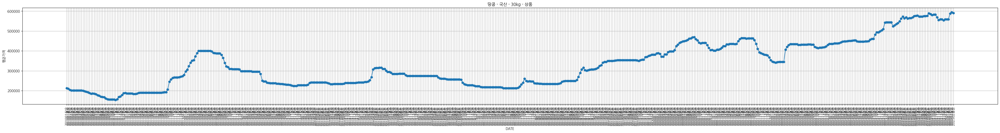

36 땅콩 국산 30kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



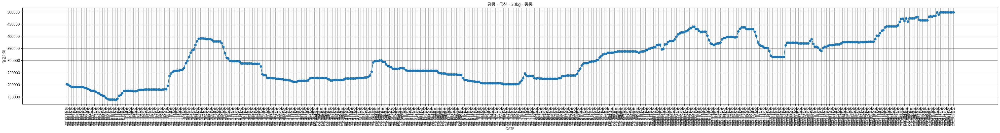

37 레몬 수입 10개 상품
  - 기간 (유효 데이터 기준): 201306상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 422
  - 결측 비율: 0.00%



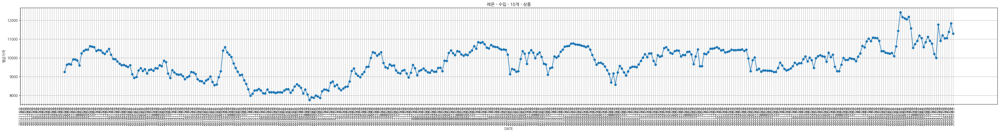

38 레몬 수입 10개 중품
  - 기간 (유효 데이터 기준): 201306상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 422
  - 결측 비율: 0.00%



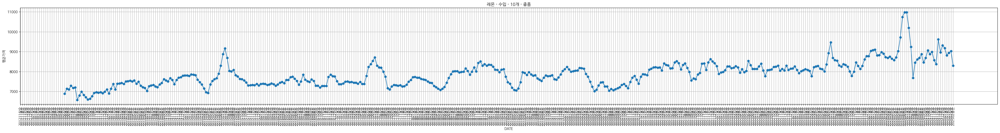

39 망고 수입 5kg 상품
  - 기간 (유효 데이터 기준): 201506상순 ~ 202501하순
  - '평균가격' 결측값 개수: 46
  - 기간 내 전체 날짜 수: 348
  - 결측 비율: 13.22%



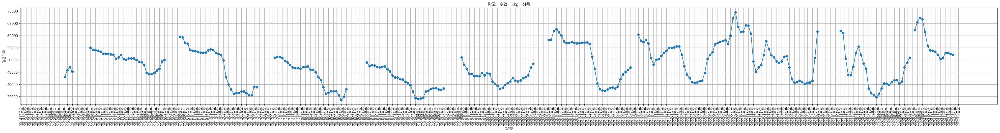

40 망고 수입 5kg 중품
  - 기간 (유효 데이터 기준): 201506상순 ~ 202501하순
  - '평균가격' 결측값 개수: 46
  - 기간 내 전체 날짜 수: 348
  - 결측 비율: 13.22%



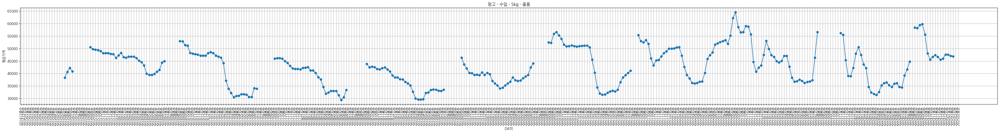

41 메밀 메밀(수입) 1kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 23
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 4.22%



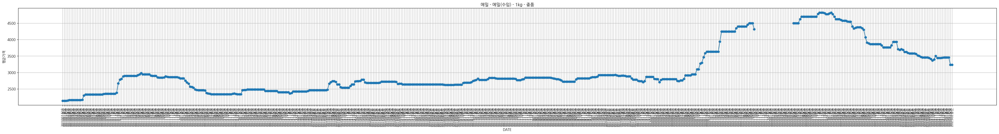

42 멜론 멜론 1개 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



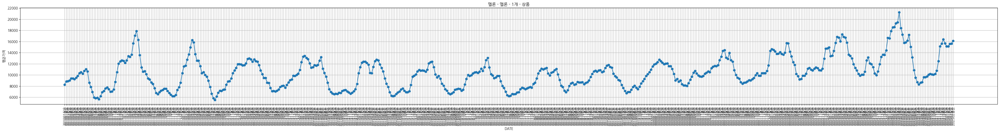

43 멜론 멜론 1개 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 130
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 23.85%



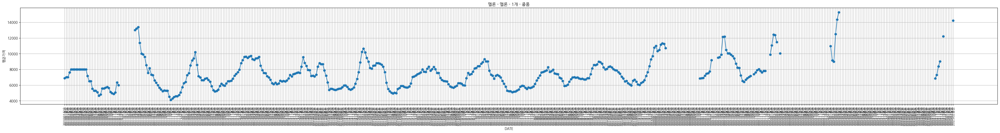

44 무 가을 20kg 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202412중순
  - '평균가격' 결측값 개수: 452
  - 기간 내 전체 날짜 수: 539
  - 결측 비율: 83.86%



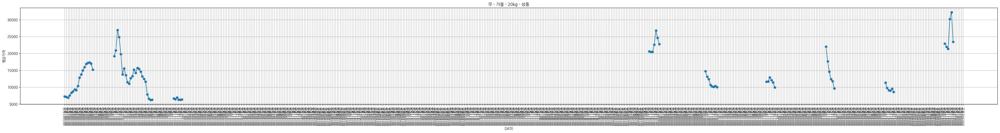

45 무 가을 20kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202412중순
  - '평균가격' 결측값 개수: 452
  - 기간 내 전체 날짜 수: 539
  - 결측 비율: 83.86%



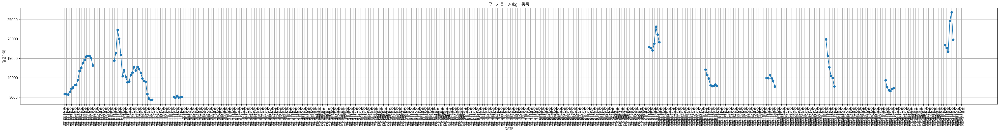

46 무 고랭지 20kg 상품
  - 기간 (유효 데이터 기준): 201008중순 ~ 202411상순
  - '평균가격' 결측값 개수: 424
  - 기간 내 전체 날짜 수: 513
  - 결측 비율: 82.65%



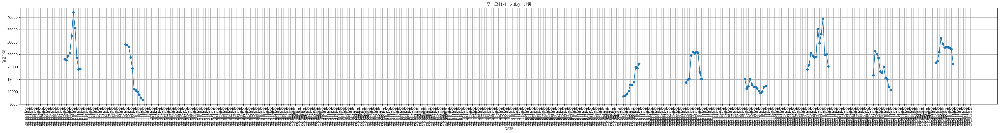

47 무 고랭지 20kg 중품
  - 기간 (유효 데이터 기준): 201008중순 ~ 202411상순
  - '평균가격' 결측값 개수: 424
  - 기간 내 전체 날짜 수: 513
  - 결측 비율: 82.65%



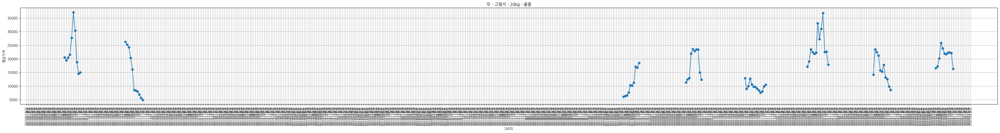

48 무 월동 20kg 상품
  - 기간 (유효 데이터 기준): 201812하순 ~ 202501하순
  - '평균가격' 결측값 개수: 99
  - 기간 내 전체 날짜 수: 220
  - 결측 비율: 45.00%



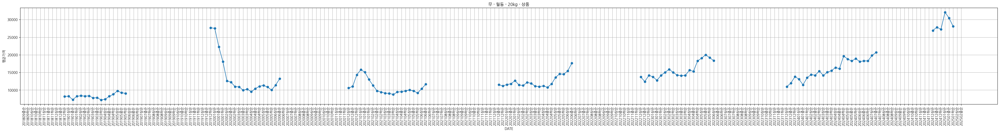

49 무 월동 20kg 중품
  - 기간 (유효 데이터 기준): 201812하순 ~ 202501하순
  - '평균가격' 결측값 개수: 99
  - 기간 내 전체 날짜 수: 220
  - 결측 비율: 45.00%



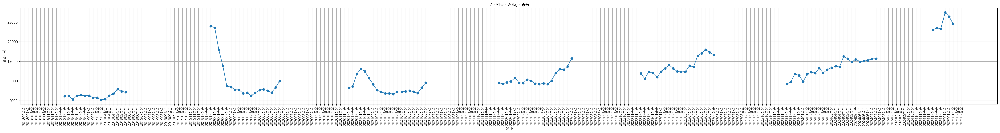

50 바나나 수입 13kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



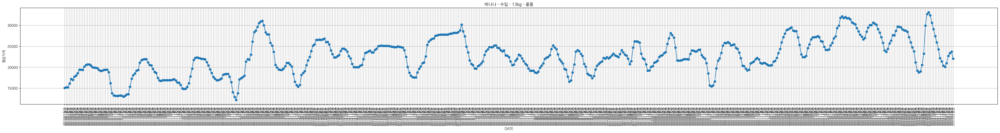

51 방울토마토 대추방울토마토 1kg 상품
  - 기간 (유효 데이터 기준): 201906중순 ~ 202501하순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 203
  - 결측 비율: 0.00%



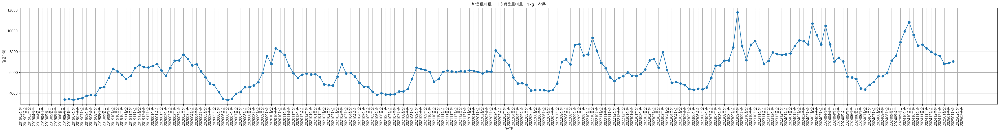

52 방울토마토 대추방울토마토 1kg 중품
  - 기간 (유효 데이터 기준): 201906중순 ~ 202501하순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 203
  - 결측 비율: 0.00%



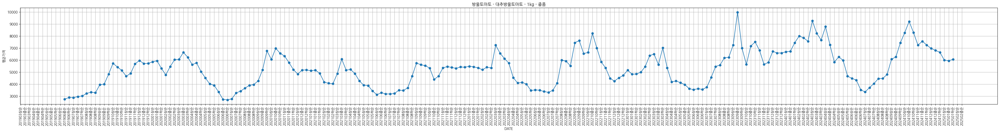

53 방울토마토 방울토마토 5kg 상품
  - 기간 (유효 데이터 기준): 201812하순 ~ 202204상순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 119
  - 결측 비율: 0.00%



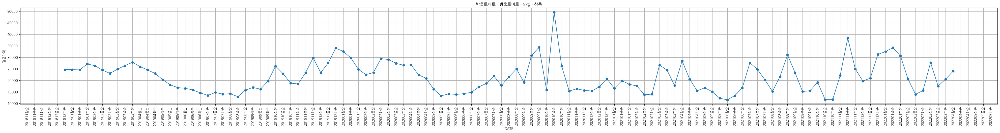

54 방울토마토 방울토마토 5kg 중품
  - 기간 (유효 데이터 기준): 201812하순 ~ 202204상순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 119
  - 결측 비율: 0.00%



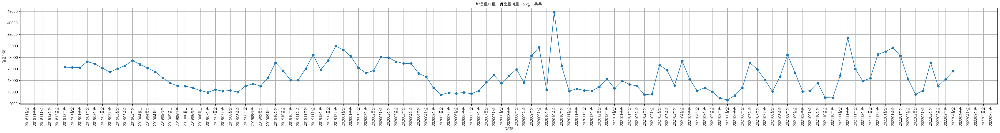

55 배 신고 15kg 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202501하순
  - '평균가격' 결측값 개수: 4
  - 기간 내 전체 날짜 수: 543
  - 결측 비율: 0.74%



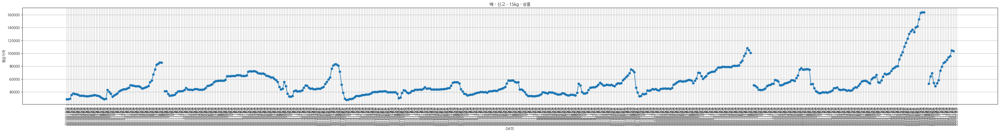

56 배 신고 15kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202501하순
  - '평균가격' 결측값 개수: 4
  - 기간 내 전체 날짜 수: 543
  - 결측 비율: 0.74%



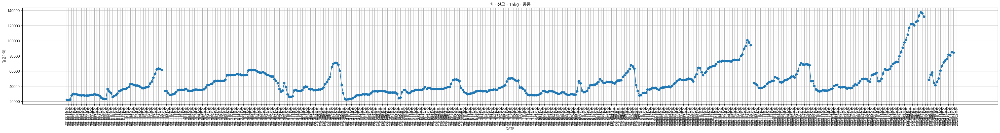

57 배추 가을 10kg 상품
  - 기간 (유효 데이터 기준): 201211중순 ~ 202212하순
  - '평균가격' 결측값 개수: 284
  - 기간 내 전체 날짜 수: 365
  - 결측 비율: 77.81%



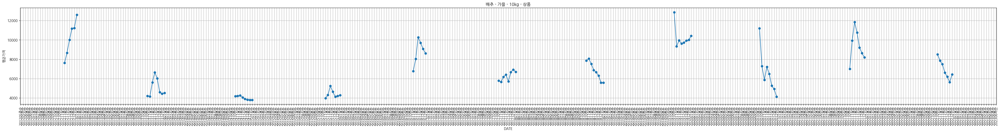

58 배추 가을 10kg 중품
  - 기간 (유효 데이터 기준): 201211중순 ~ 202212하순
  - '평균가격' 결측값 개수: 284
  - 기간 내 전체 날짜 수: 365
  - 결측 비율: 77.81%



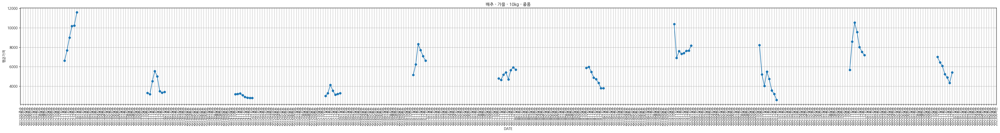

59 배추 고랭지 10kg 상품
  - 기간 (유효 데이터 기준): 201207하순 ~ 202210중순
  - '평균가격' 결측값 개수: 249
  - 기간 내 전체 날짜 수: 369
  - 결측 비율: 67.48%



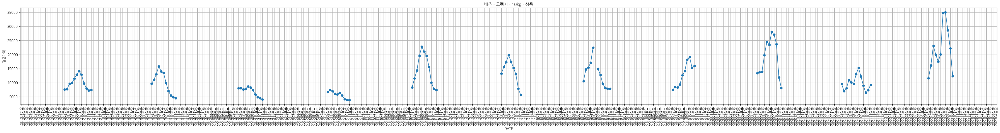

60 배추 고랭지 10kg 중품
  - 기간 (유효 데이터 기준): 201207하순 ~ 202210중순
  - '평균가격' 결측값 개수: 249
  - 기간 내 전체 날짜 수: 369
  - 결측 비율: 67.48%



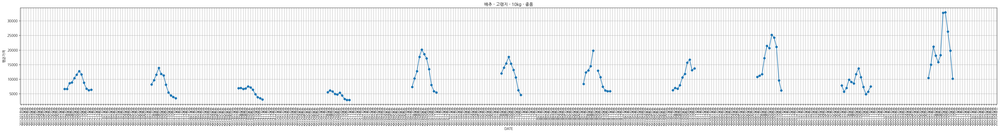

61 배추 봄 10kg 상품
  - 기간 (유효 데이터 기준): 201204중순 ~ 202307중순
  - '평균가격' 결측값 개수: 299
  - 기간 내 전체 날짜 수: 406
  - 결측 비율: 73.65%



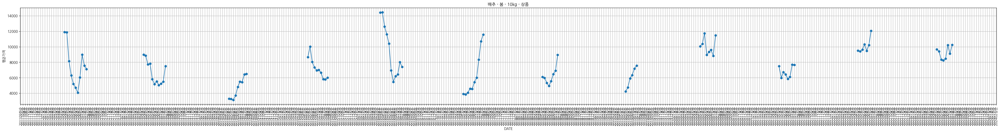

62 배추 봄 10kg 중품
  - 기간 (유효 데이터 기준): 201204중순 ~ 202307중순
  - '평균가격' 결측값 개수: 299
  - 기간 내 전체 날짜 수: 406
  - 결측 비율: 73.65%



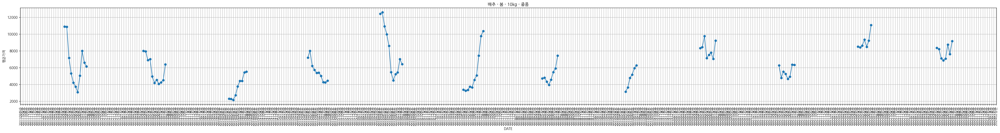

63 배추 월동 10kg 상품
  - 기간 (유효 데이터 기준): 201201상순 ~ 202305중순
  - '평균가격' 결측값 개수: 238
  - 기간 내 전체 날짜 수: 410
  - 결측 비율: 58.05%



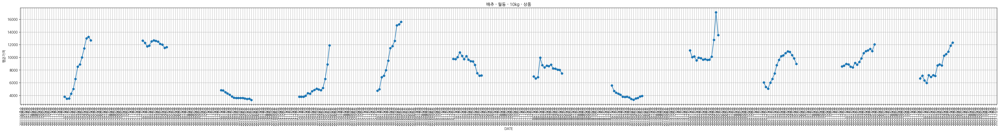

64 배추 월동 10kg 중품
  - 기간 (유효 데이터 기준): 201201상순 ~ 202305중순
  - '평균가격' 결측값 개수: 238
  - 기간 내 전체 날짜 수: 410
  - 결측 비율: 58.05%



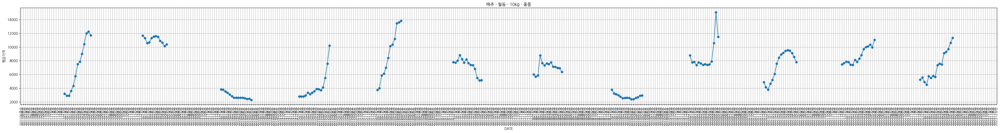

65 사과 홍로 10kg 상품
  - 기간 (유효 데이터 기준): 201009상순 ~ 202410중순
  - '평균가격' 결측값 개수: 403
  - 기간 내 전체 날짜 수: 509
  - 결측 비율: 79.17%



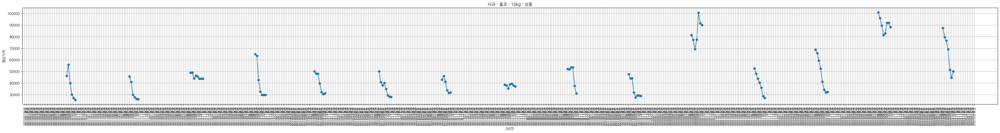

66 사과 홍로 10kg 중품
  - 기간 (유효 데이터 기준): 201009상순 ~ 202410중순
  - '평균가격' 결측값 개수: 403
  - 기간 내 전체 날짜 수: 509
  - 결측 비율: 79.17%



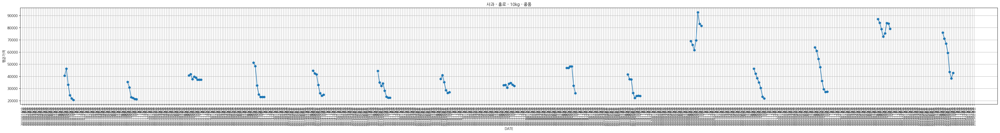

67 사과 후지 10kg 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202501하순
  - '평균가격' 결측값 개수: 78
  - 기간 내 전체 날짜 수: 543
  - 결측 비율: 14.36%



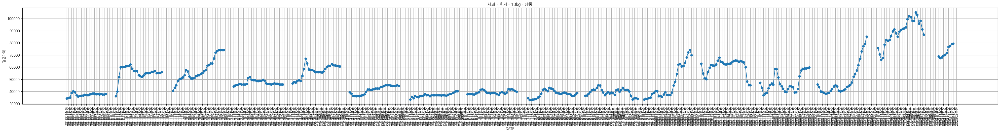

68 사과 후지 10kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202501하순
  - '평균가격' 결측값 개수: 78
  - 기간 내 전체 날짜 수: 543
  - 결측 비율: 14.36%



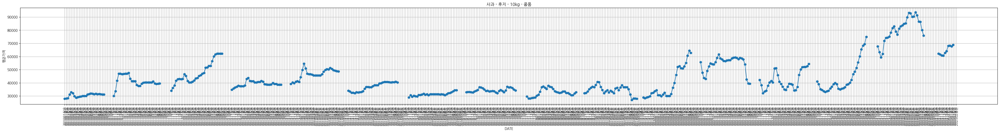

69 상추 적 4kg 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202501하순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 543
  - 결측 비율: 0.00%



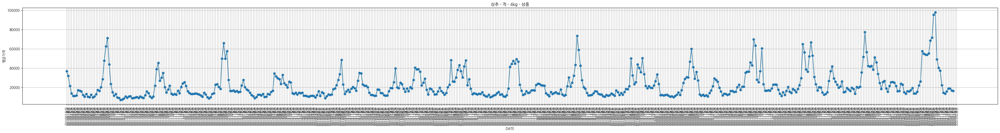

70 상추 적 4kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202501하순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 543
  - 결측 비율: 0.00%



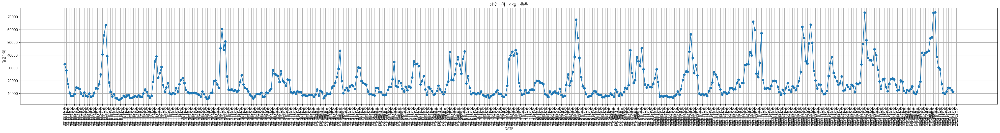

71 상추 청 4kg 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202501하순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 543
  - 결측 비율: 0.00%



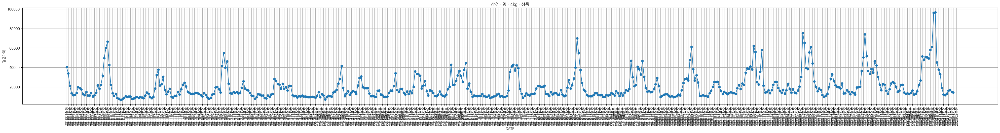

72 상추 청 4kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202501하순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 543
  - 결측 비율: 0.00%



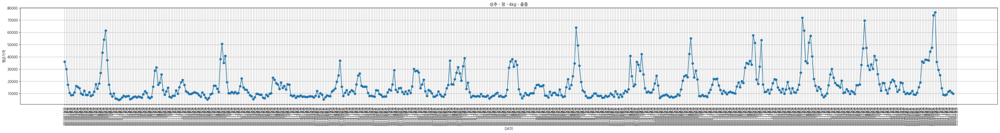

73 새송이버섯 새송이버섯 2kg 중품
  - 기간 (유효 데이터 기준): 201101상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 509
  - 결측 비율: 0.00%



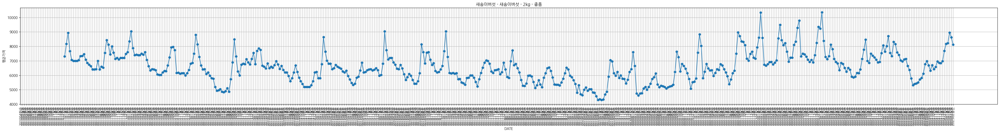

74 생강 국산 10kg 중품
  - 기간 (유효 데이터 기준): 202203하순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 105
  - 결측 비율: 0.00%



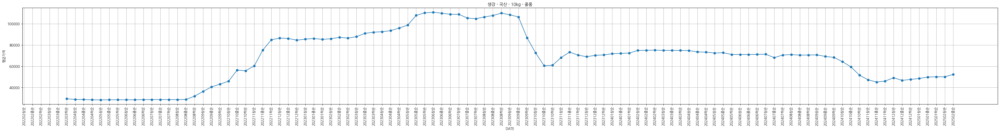

75 생강 수입 10kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



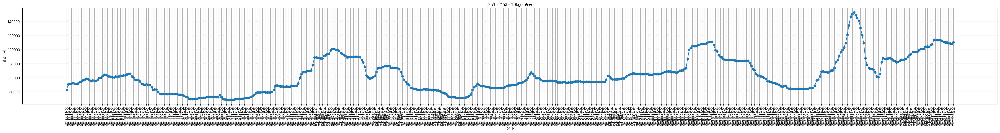

76 수박 수박 1개 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 11
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 2.02%



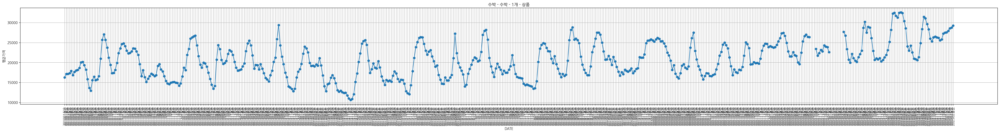

77 수박 수박 1개 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 3
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.55%



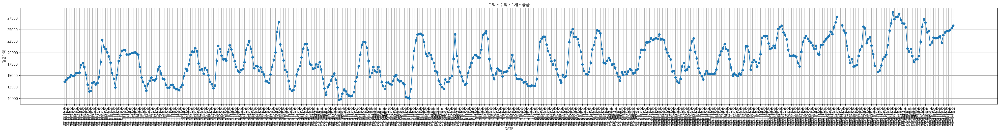

78 아몬드 수입 100g 중품
  - 기간 (유효 데이터 기준): 201306상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 422
  - 결측 비율: 0.00%



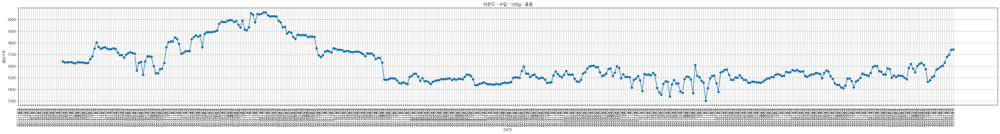

79 아보카도 수입 1개 상품
  - 기간 (유효 데이터 기준): 202204상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 104
  - 결측 비율: 0.00%



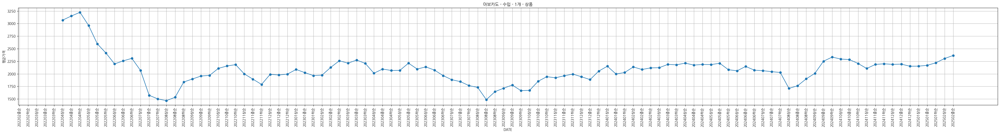

80 양배추 양배추 8kg 중품
  - 기간 (유효 데이터 기준): 201201상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 473
  - 결측 비율: 0.00%



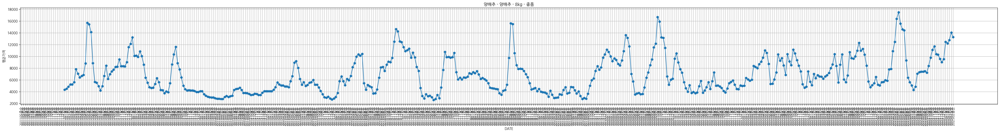

81 양파 양파 15kg 상품
  - 기간 (유효 데이터 기준): 202203하순 ~ 202501하순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 103
  - 결측 비율: 0.00%



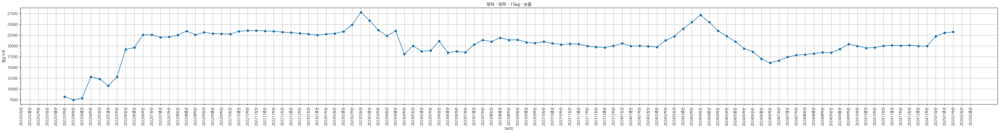

82 양파 양파 15kg 중품
  - 기간 (유효 데이터 기준): 202203하순 ~ 202501하순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 103
  - 결측 비율: 0.00%



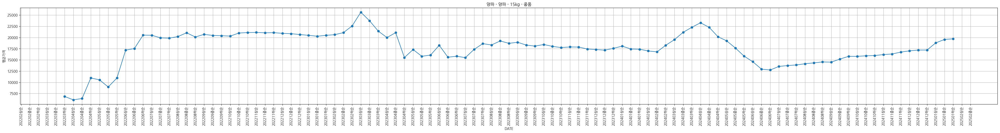

83 열무 열무 4kg 상품
  - 기간 (유효 데이터 기준): 201201상순 ~ 202501하순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 471
  - 결측 비율: 0.00%



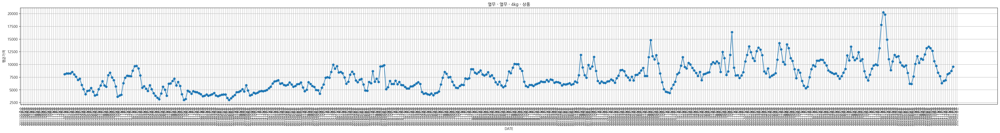

84 열무 열무 4kg 중품
  - 기간 (유효 데이터 기준): 201201상순 ~ 202501하순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 471
  - 결측 비율: 0.00%



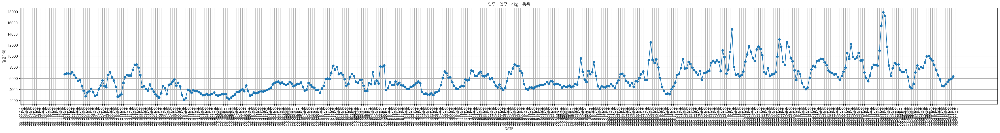

85 오렌지 네이블 미국 18kg 상품
  - 기간 (유효 데이터 기준): 201812하순 ~ 202502중순
  - '평균가격' 결측값 개수: 104
  - 기간 내 전체 날짜 수: 222
  - 결측 비율: 46.85%



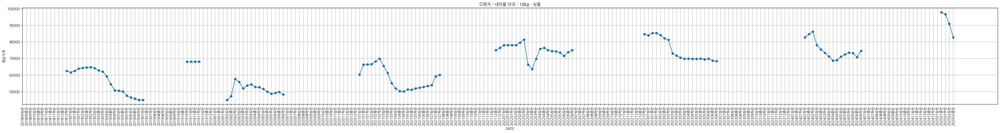

86 오렌지 네이블 호주 18kg 상품
  - 기간 (유효 데이터 기준): 201808상순 ~ 202411중순
  - '평균가격' 결측값 개수: 120
  - 기간 내 전체 날짜 수: 227
  - 결측 비율: 52.86%



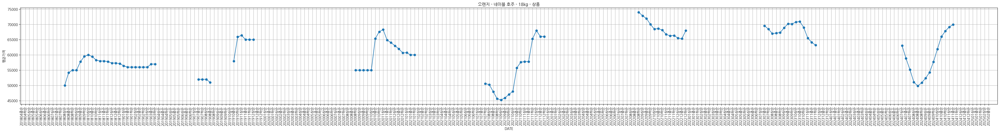

87 오렌지 발렌시아 미국 18kg 상품
  - 기간 (유효 데이터 기준): 201807하순 ~ 202408상순
  - '평균가격' 결측값 개수: 150
  - 기간 내 전체 날짜 수: 218
  - 결측 비율: 68.81%



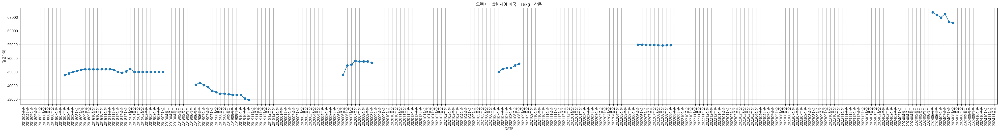

88 오이 가시계통 10kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 223
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 40.92%



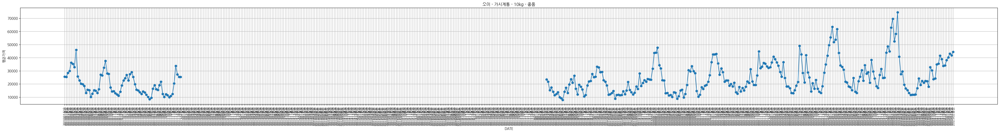

89 오이 다다기계통 100개 중품
  - 기간 (유효 데이터 기준): 201201상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 473
  - 결측 비율: 0.00%



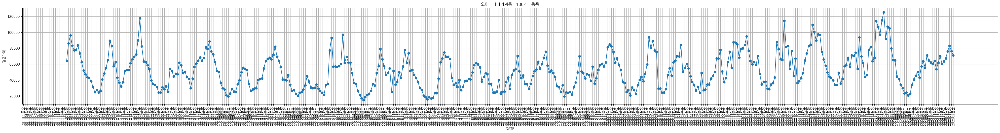

90 오이 취청 50개 중품
  - 기간 (유효 데이터 기준): 201201상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 473
  - 결측 비율: 0.00%



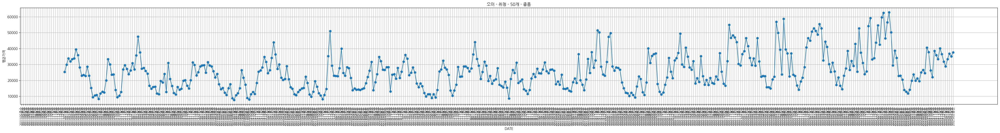

91 참깨 백색(국산) 30kg 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



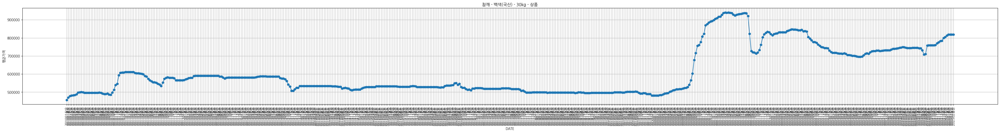

92 참다래 국산 10kg 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202304하순
  - '평균가격' 결측값 개수: 254
  - 기간 내 전체 날짜 수: 480
  - 결측 비율: 52.92%



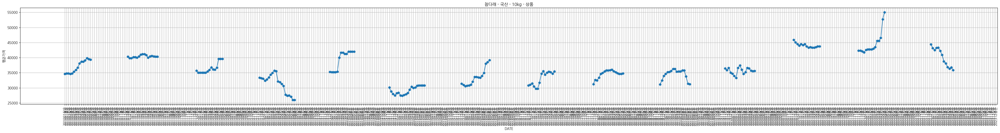

93 참다래 그린 뉴질랜드 10kg 상품
  - 기간 (유효 데이터 기준): 201807하순 ~ 202412상순
  - '평균가격' 결측값 개수: 70
  - 기간 내 전체 날짜 수: 230
  - 결측 비율: 30.43%



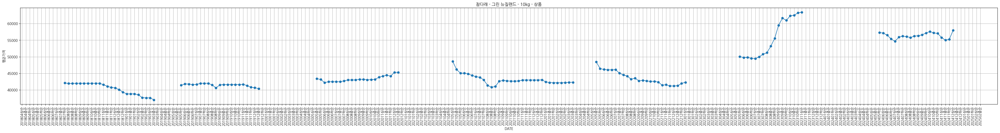

94 참외 참외 10kg 상품
  - 기간 (유효 데이터 기준): 201004하순 ~ 202408하순
  - '평균가격' 결측값 개수: 233
  - 기간 내 전체 날짜 수: 517
  - 결측 비율: 45.07%



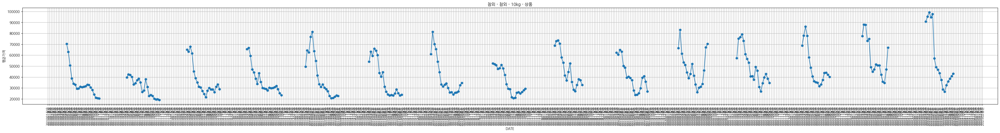

95 체리 수입 5kg 상품
  - 기간 (유효 데이터 기준): 201506상순 ~ 202408중순
  - '평균가격' 결측값 개수: 215
  - 기간 내 전체 날짜 수: 332
  - 결측 비율: 64.76%



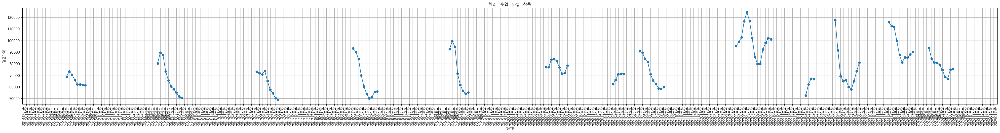

96 콩 흰 콩(국산) 500g 상품
  - 기간 (유효 데이터 기준): 201812하순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 222
  - 결측 비율: 0.00%



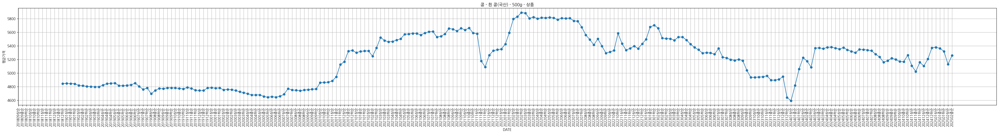

97 콩 흰 콩(국산) 500g 중품
  - 기간 (유효 데이터 기준): 201812하순 ~ 202206중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 126
  - 결측 비율: 0.00%



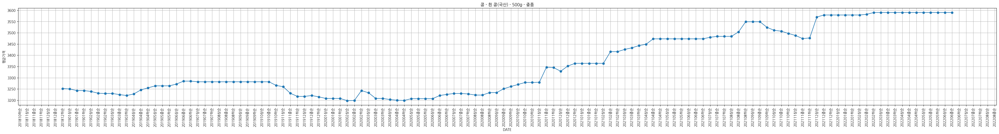

98 콩나물 풀무원 국산콩 콩나물 340g 1봉 상품
  - 기간 (유효 데이터 기준): 202101상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 149
  - 결측 비율: 0.00%



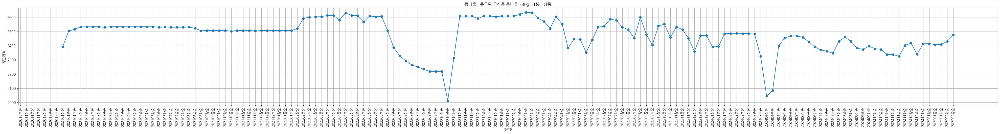

99 토마토 토마토 1kg 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



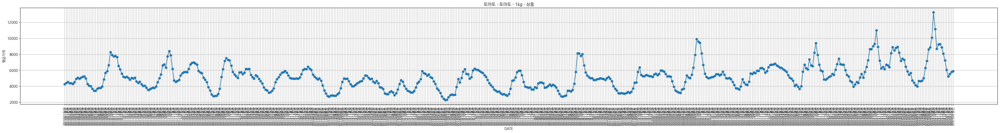

100 토마토 토마토 1kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202204하순
  - '평균가격' 결측값 개수: 25
  - 기간 내 전체 날짜 수: 444
  - 결측 비율: 5.63%



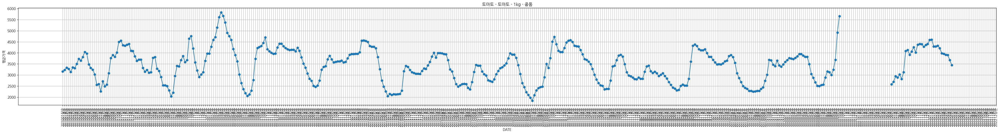

101 파 대파 1kg 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



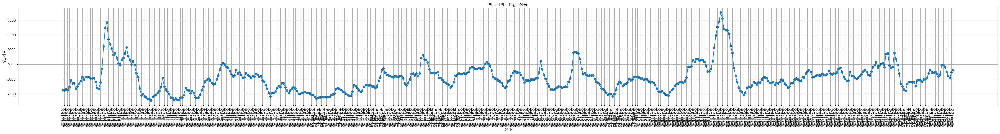

102 파 대파 1kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 1
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.18%



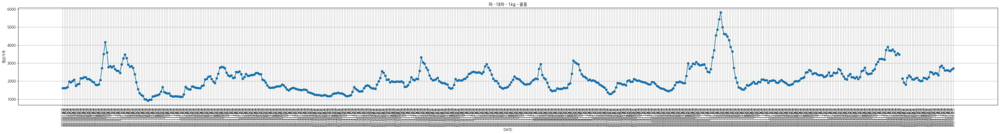

103 파 쪽파 1kg 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



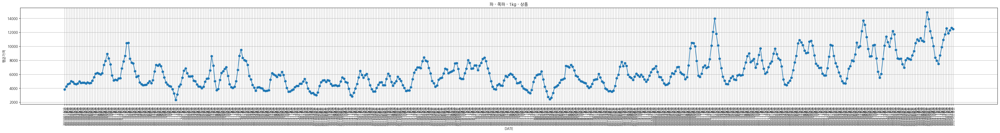

104 파 쪽파 1kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202407상순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 523
  - 결측 비율: 0.00%



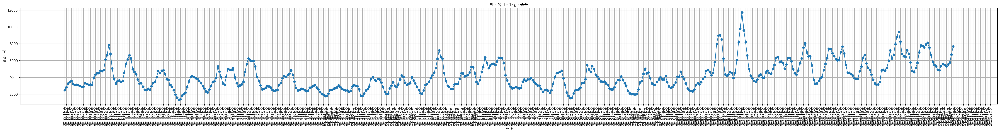

105 파인애플 수입 1개 상품
  - 기간 (유효 데이터 기준): 201506상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 350
  - 결측 비율: 0.00%



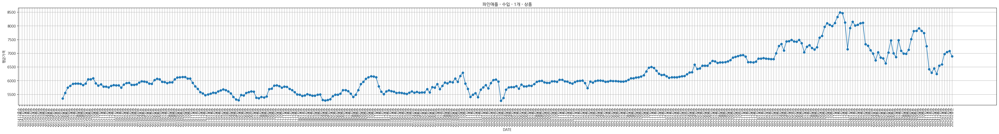

106 파인애플 수입 1개 중품
  - 기간 (유효 데이터 기준): 201506상순 ~ 202502중순
  - '평균가격' 결측값 개수: 19
  - 기간 내 전체 날짜 수: 350
  - 결측 비율: 5.43%



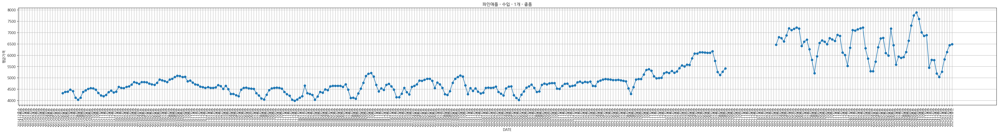

107 파프리카 파프리카 5kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



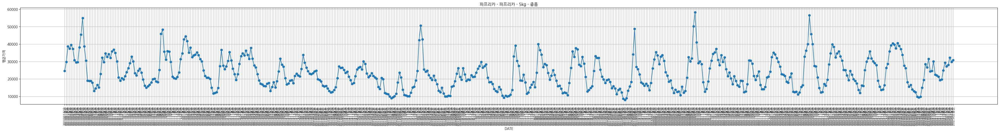

108 팥 붉은 팥(국산) 40kg 상품
  - 기간 (유효 데이터 기준): 201812하순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 222
  - 결측 비율: 0.00%



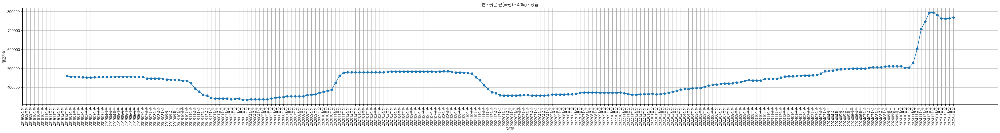

109 팥 붉은 팥(국산) 40kg 중품
  - 기간 (유효 데이터 기준): 201812하순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 222
  - 결측 비율: 0.00%



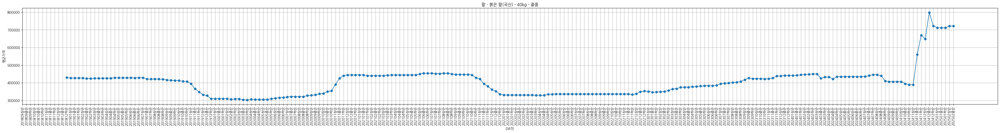

110 팥 붉은 팥(수입) 40kg 중품
  - 기간 (유효 데이터 기준): 201812하순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 222
  - 결측 비율: 0.00%



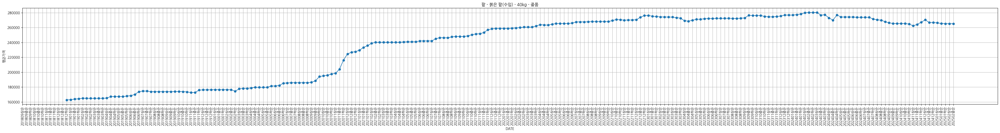

111 팽이버섯 팽이버섯 5kg 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



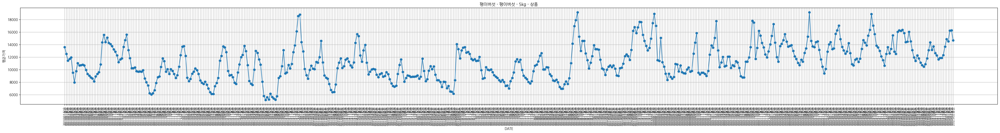

112 팽이버섯 팽이버섯 5kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



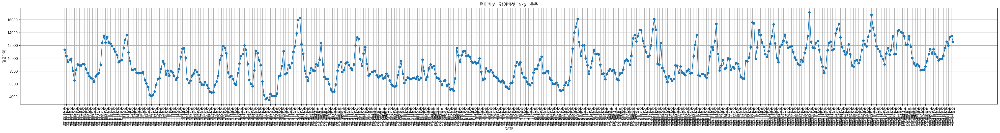

113 포도 MBA 5kg 상품
  - 기간 (유효 데이터 기준): 201010상순 ~ 202211상순
  - '평균가격' 결측값 개수: 359
  - 기간 내 전체 날짜 수: 436
  - 결측 비율: 82.34%



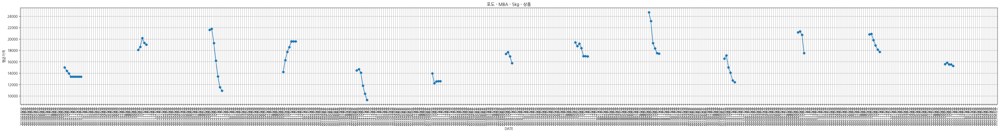

114 포도 MBA 5kg 중품
  - 기간 (유효 데이터 기준): 201010상순 ~ 202211상순
  - '평균가격' 결측값 개수: 359
  - 기간 내 전체 날짜 수: 436
  - 결측 비율: 82.34%



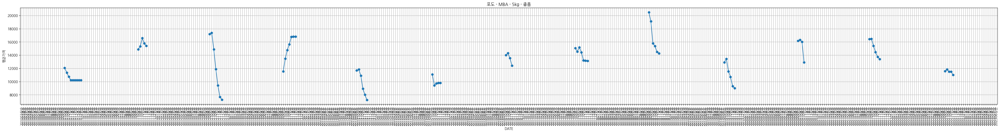

115 포도 거봉 2kg 상품
  - 기간 (유효 데이터 기준): 201007중순 ~ 202210중순
  - '평균가격' 결측값 개수: 292
  - 기간 내 전체 날짜 수: 442
  - 결측 비율: 66.06%



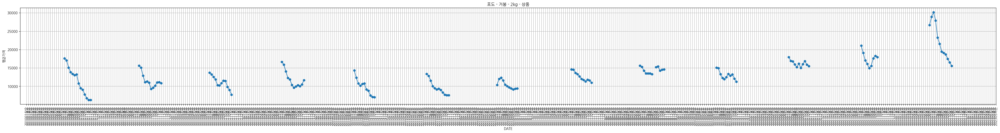

116 포도 거봉 2kg 중품
  - 기간 (유효 데이터 기준): 201007중순 ~ 202210중순
  - '평균가격' 결측값 개수: 292
  - 기간 내 전체 날짜 수: 442
  - 결측 비율: 66.06%



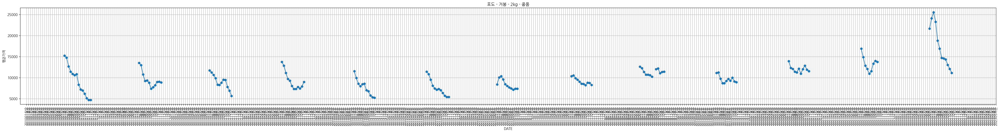

117 포도 캠벨얼리 5kg 상품
  - 기간 (유효 데이터 기준): 201007중순 ~ 202211상순
  - '평균가격' 결측값 개수: 296
  - 기간 내 전체 날짜 수: 444
  - 결측 비율: 66.67%



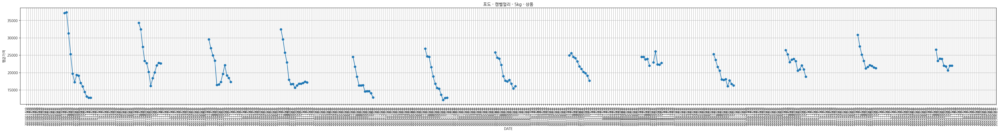

118 포도 캠벨얼리 5kg 중품
  - 기간 (유효 데이터 기준): 201007중순 ~ 202211상순
  - '평균가격' 결측값 개수: 296
  - 기간 내 전체 날짜 수: 444
  - 결측 비율: 66.67%



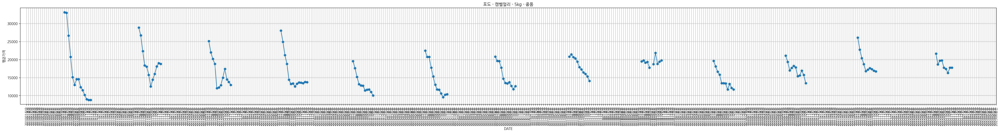

119 풋고추 꽈리고추 4kg 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



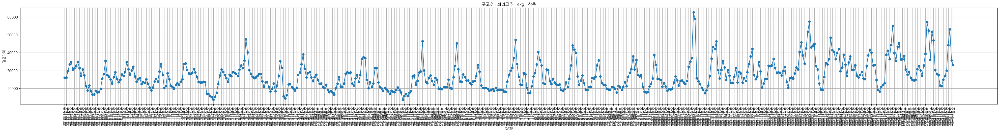

120 풋고추 꽈리고추 4kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



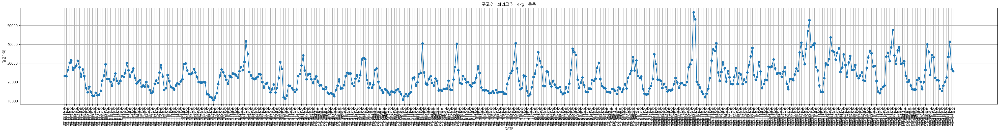

121 풋고추 오이맛고추 10kg 상품
  - 기간 (유효 데이터 기준): 202204상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 104
  - 결측 비율: 0.00%



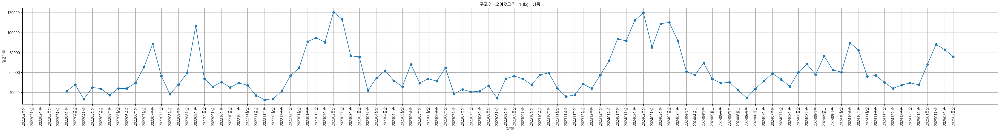

122 풋고추 오이맛고추 10kg 중품
  - 기간 (유효 데이터 기준): 202204상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 104
  - 결측 비율: 0.00%



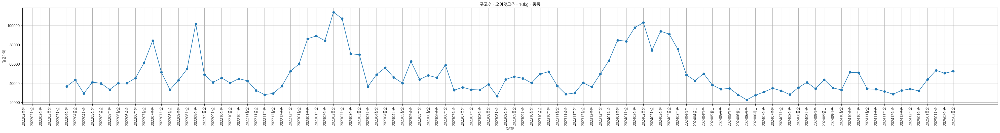

123 풋고추 청양고추 10kg 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



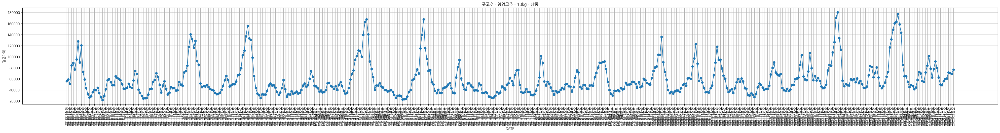

124 풋고추 청양고추 10kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



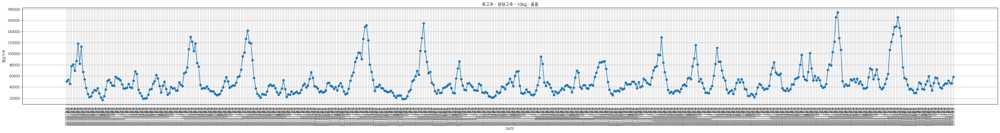

125 풋고추 풋고추 10kg 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202310중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 497
  - 결측 비율: 0.00%



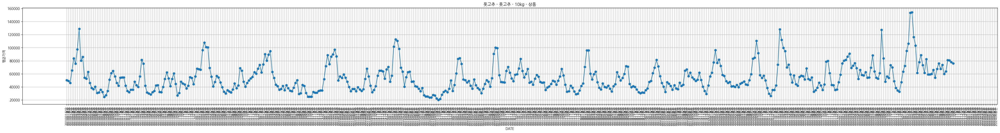

126 풋고추 풋고추 10kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202310중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 497
  - 결측 비율: 0.00%



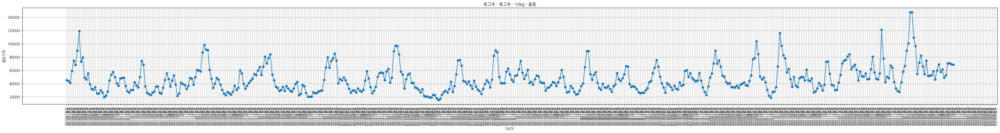

127 피망 청 10kg 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



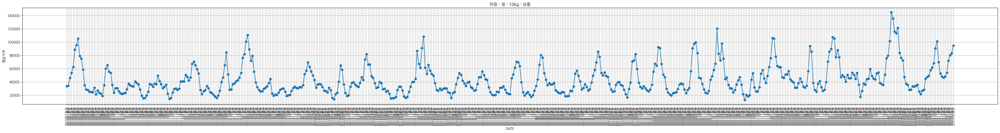

128 피망 청 10kg 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



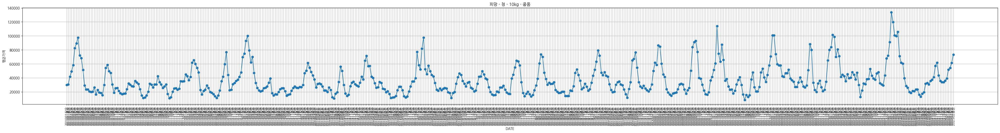

129 호두 수입 100g 중품
  - 기간 (유효 데이터 기준): 201306상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 422
  - 결측 비율: 0.00%



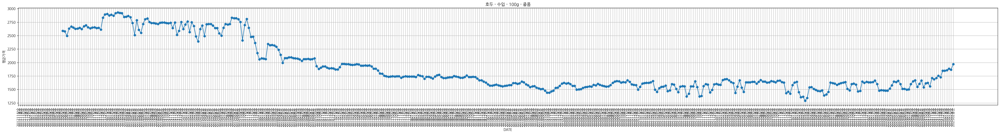

130 호박 애호박 1개 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



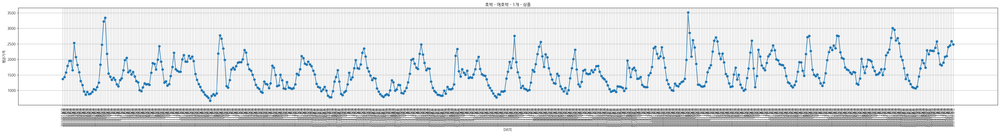

131 호박 애호박 1개 중품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



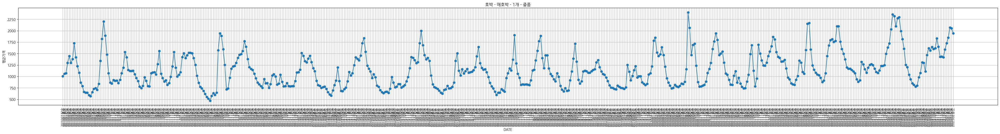

132 호박 쥬키니 1개 상품
  - 기간 (유효 데이터 기준): 201001상순 ~ 202502중순
  - '평균가격' 결측값 개수: 0
  - 기간 내 전체 날짜 수: 545
  - 결측 비율: 0.00%



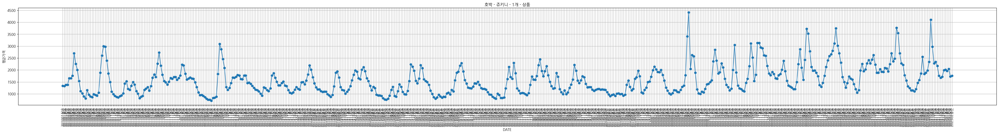

In [18]:
import matplotlib.pyplot as plt

import matplotlib.font_manager as fm

# 한글 폰트 설정
font_path = 'c:/Windows/Fonts/NANUMGOTHIC.TTF '  # 폰트 경로
font_prop = fm.FontProperties(fname=font_path, size=12)
# 한글 폰트 설정 (예: 나눔고딕)
plt.rcParams['font.family'] = 'NanumGothic'

# 경고 메시지 제거
plt.rcParams['axes.unicode_minus'] = False

# X축(DATE) 값 통일을 위해 모든 DATE 값 가져오기 (오름차순 정렬)
unique_dates = sorted(filtered_df['DATE'].unique())

# 품목, 품종, 거래단위, 등급 별로 그룹화
grouped = filtered_df.groupby(['품목', '품종', '거래단위', '등급'])
num=1
# 결과 저장용 리스트 초기화
results = []

# 그래프 그리기 및 결과 계산
for (품목, 품종, 거래단위, 등급), group in grouped:
    plt.figure(figsize=(50, 5))  # 그래프 크기 조정
    print(num, 품목, 품종, 거래단위, 등급)
    
    # 기존 코드: DATE 오름차순 정렬 및 전체 날짜(unique_dates)로 재배열
    group = group.set_index('DATE').reindex(unique_dates).reset_index()
    
    # 이웃 결측치 처리: 각 행의 앞뒤 3개(총 6개) 이웃에서 결측치가 4개 이상이면 해당 행의 '평균가격'을 NaN으로 변경
    updated_prices = group['평균가격'].copy()
    for i in range(len(updated_prices)):
        start = max(0, i - 3)
        end = min(len(updated_prices) - 1, i + 3)
        # 자기 자신 제외한 이웃 값들
        neighbors = updated_prices.iloc[start:i].tolist() + updated_prices.iloc[i+1:end+1].tolist()
        missing_neighbors = sum(pd.isna(x) for x in neighbors)
        if missing_neighbors >= 4:
            updated_prices.iloc[i] = np.nan
    group['평균가격'] = updated_prices

    # 결측치 처리 후, 유효한 '평균가격'이 있는 날짜들을 기준으로 첫 출현 날짜와 마지막 출현 날짜 계산
    valid_dates = group.loc[~group['평균가격'].isna(), 'DATE']
    if len(valid_dates) > 0:
        valid_first_date = valid_dates.min()
        valid_last_date = valid_dates.max()
    else:
        valid_first_date = group['DATE'].min()
        valid_last_date = group['DATE'].max()
    
    # 유효 데이터가 존재하는 기간(유효 날짜 기준)만 필터링
    period_group = group[(group['DATE'] >= valid_first_date) & (group['DATE'] <= valid_last_date)]
    
    # '평균가격' 결측값 개수 및 해당 기간 내 전체 날짜 수 계산 (분모는 유효 기간의 날짜 수)
    missing_count = period_group['평균가격'].isna().sum()
    total_period = len(period_group)
    missing_ratio = (missing_count / total_period) * 100 if total_period > 0 else 0
    
    # 결과 출력
    print(f"  - 기간 (유효 데이터 기준): {valid_first_date} ~ {valid_last_date}")
    print(f"  - '평균가격' 결측값 개수: {missing_count}")
    print(f"  - 기간 내 전체 날짜 수: {total_period}")
    print(f"  - 결측 비율: {missing_ratio:.2f}%\n")
    
    # 결과를 리스트에 저장
    results.append({
        '품목': 품목,
        '품종': 품종,
        '거래단위': 거래단위,
        '등급': 등급,
        '유효시작날짜': valid_first_date,
        '유효종료날짜': valid_last_date,
        '결측값개수': missing_count,
        '기간내전체날짜수': total_period,
        '결측비율(%)': missing_ratio
    })
    
    # 그래프 그리기 (X축: 통일된 DATE, Y축: 평균가격)
    plt.plot(group['DATE'], group['평균가격'], marker='o', linestyle='-')
    plt.title(f'{품목} - {품종} - {거래단위} - {등급}')
    plt.xlabel('DATE')
    plt.ylabel('평균가격')
    plt.xticks(rotation=90)
    plt.grid(True)
    plt.show()
    
    num += 1

# 결과 리스트를 DataFrame으로 변환 후 CSV 파일로 저장 (인덱스 없이)
result_df = pd.DataFrame(results)
result_df
result_df.to_csv("output_missing_ratio.csv", index=False)


Cluster 0 포함 품종: ['건고추(전체)' '깻잎(전체)' '바나나(전체)' '수박(전체)' '참깨(전체)' '콩(전체)' '파(전체)' '팥(전체)'
 '풋고추(전체)' '호박(전체)']


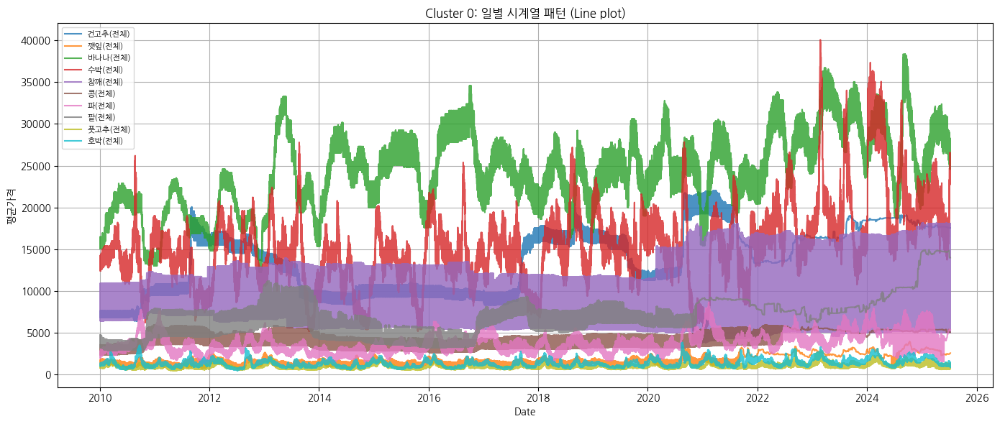

Cluster 1 포함 품종: ['감자(전체)' '깐마늘(국산)(전체)' '단감(전체)' '딸기(전체)' '땅콩(전체)' '멜론(전체)' '무(전체)'
 '배(전체)' '사과(전체)' '상추(전체)' '양배추(전체)' '오이(전체)' '토마토(전체)' '피망(전체)']


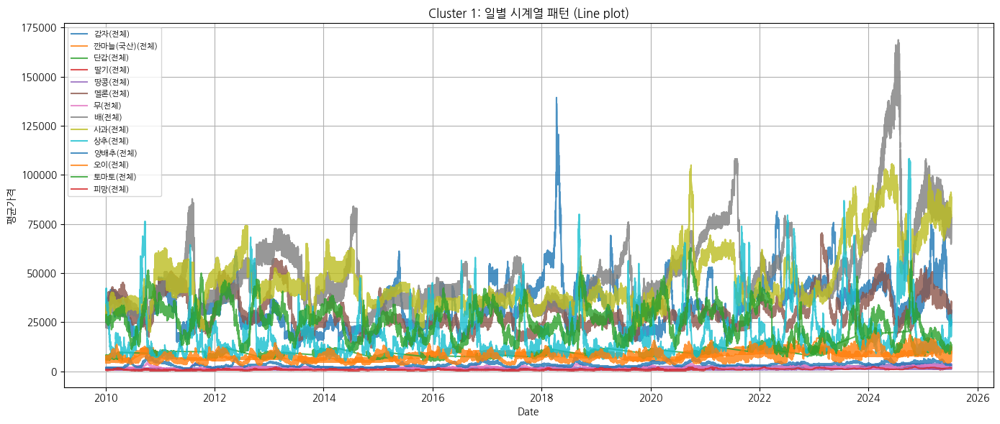

Cluster 2 포함 품종: ['고구마(전체)' '느타리버섯(전체)' '당근(전체)' '메밀(전체)' '방울토마토(전체)' '배추(전체)' '생강(전체)'
 '양파(전체)' '오렌지(전체)' '파프리카(전체)' '팽이버섯(전체)']


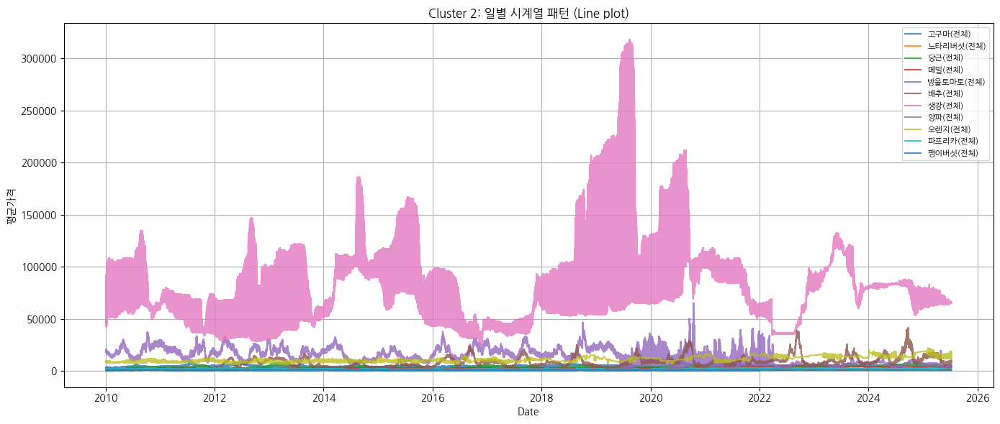

In [20]:
import pandas as pd
import matplotlib.pyplot as plt
import glob
import os

# 클러스터 결과 CSV 불러오기
result_df = pd.read_csv("clustering_result_tsne.csv", encoding='utf-8-sig')

# 데이터셋 폴더
data_dir = "./dataset"

# Cluster 목록
clusters = sorted(result_df['Cluster'].unique())

for cluster in clusters:
    cluster_varieties = result_df[result_df['Cluster'] == cluster]['Variety'].values

    plt.figure(figsize=(14, 6))
    print(f"Cluster {cluster} 포함 품종:", cluster_varieties)

    for variety in cluster_varieties:
        # 데이터 파일 탐색
        matched_file = None
        for file_path in glob.glob(os.path.join(data_dir, "*.xlsx")):
            df = pd.read_excel(file_path)
            if variety in df['품종'].unique():
                matched_file = file_path
                break

        if matched_file is None:
            print(f"⚠️ 파일 찾기 실패: {variety}")
            continue

        # 시계열 데이터 로드
        df = pd.read_excel(matched_file)
        df['DATE'] = pd.to_datetime(df['DATE'], errors='coerce')
        df['평균가격'] = pd.to_numeric(df['평균가격'], errors='coerce').fillna(0)

        sub_df = df[df['품종'] == variety].copy().sort_values(by='DATE')
        plt.plot(sub_df['DATE'], sub_df['평균가격'], label=variety, alpha=0.8)

    plt.title(f"Cluster {cluster}: 일별 시계열 패턴 (Line plot)")
    plt.xlabel("Date")
    plt.ylabel("평균가격")
    plt.legend(fontsize=8)
    plt.grid(True)
    plt.tight_layout()
    plt.show()


Cluster 0 포함 품종: ['건고추(전체)' '깻잎(전체)' '바나나(전체)' '수박(전체)' '참깨(전체)' '콩(전체)' '파(전체)' '팥(전체)'
 '풋고추(전체)' '호박(전체)']


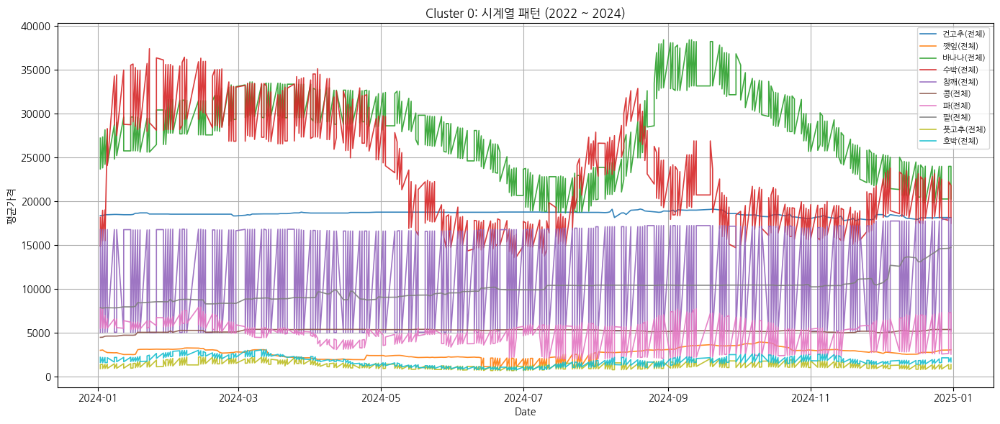

Cluster 1 포함 품종: ['감자(전체)' '깐마늘(국산)(전체)' '단감(전체)' '딸기(전체)' '땅콩(전체)' '멜론(전체)' '무(전체)'
 '배(전체)' '사과(전체)' '상추(전체)' '양배추(전체)' '오이(전체)' '토마토(전체)' '피망(전체)']


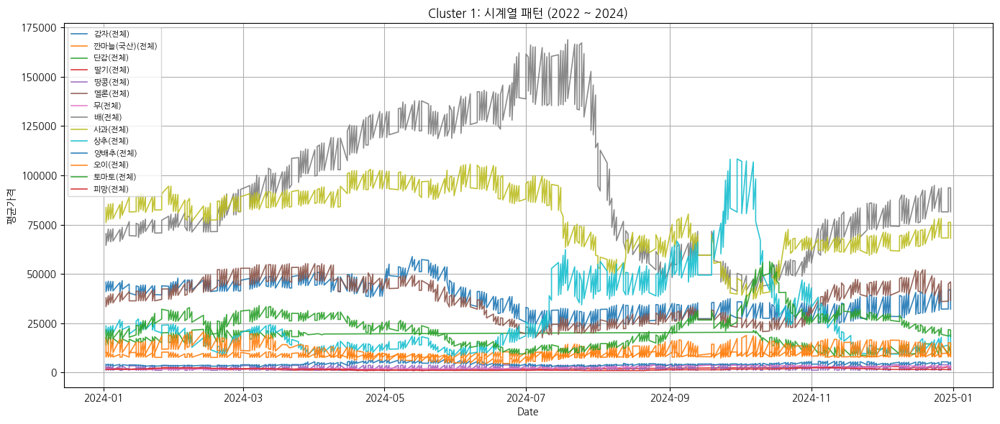

Cluster 2 포함 품종: ['고구마(전체)' '느타리버섯(전체)' '당근(전체)' '메밀(전체)' '방울토마토(전체)' '배추(전체)' '생강(전체)'
 '양파(전체)' '오렌지(전체)' '파프리카(전체)' '팽이버섯(전체)']


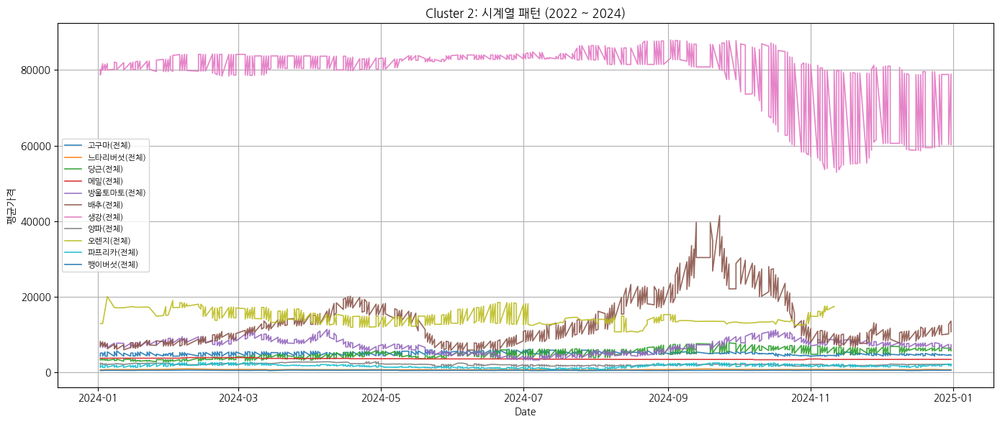

In [23]:
for cluster in clusters:
    cluster_varieties = result_df[result_df['Cluster'] == cluster]['Variety'].values

    plt.figure(figsize=(14, 6))
    print(f"Cluster {cluster} 포함 품종:", cluster_varieties)

    for variety in cluster_varieties:
        # 데이터 파일 탐색
        matched_file = None
        for file_path in glob.glob(os.path.join(data_dir, "*.xlsx")):
            df = pd.read_excel(file_path)
            if variety in df['품종'].unique():
                matched_file = file_path
                break

        if matched_file is None:
            print(f"⚠️ 파일 찾기 실패: {variety}")
            continue

        # 시계열 데이터 로드
        df = pd.read_excel(matched_file)
        df['DATE'] = pd.to_datetime(df['DATE'], errors='coerce')
        df['평균가격'] = pd.to_numeric(df['평균가격'], errors='coerce').fillna(0)

        # 2022년 이후 데이터만 선택
        sub_df = df[df['품종'] == variety].copy().sort_values(by='DATE')
        sub_df = sub_df[(sub_df['DATE'] >= "2024-01-01") & (sub_df['DATE'] <= "2024-12-31")]

        if sub_df.empty:
            continue

        plt.plot(sub_df['DATE'], sub_df['평균가격'], label=variety, linewidth=1.2, alpha=0.9)

    plt.title(f"Cluster {cluster}: 시계열 패턴 (2022 ~ 2024)")
    plt.xlabel("Date")
    plt.ylabel("평균가격")
    plt.legend(fontsize=8)
    plt.grid(True)
    plt.tight_layout()
    plt.show()

In [24]:
import pandas as pd
import numpy as np
import glob
import os

# 클러스터 결과 CSV 불러오기
result_df = pd.read_csv("clustering_result_tsne.csv", encoding='utf-8-sig')

# 데이터셋 폴더
data_dir = "./dataset"

# 결과 저장용 리스트
detailed_stats = []

# Cluster 목록
clusters = sorted(result_df['Cluster'].unique())

for cluster in clusters:
    cluster_varieties = result_df[result_df['Cluster'] == cluster]['Variety'].values

    for variety in cluster_varieties:
        # 파일 찾기
        matched_file = None
        for file_path in glob.glob(os.path.join(data_dir, "*.xlsx")):
            df = pd.read_excel(file_path)
            if variety in df['품종'].unique():
                matched_file = file_path
                break

        if matched_file is None:
            print(f"⚠️ 파일 찾기 실패: {variety}")
            continue

        # 시계열 데이터 로드
        df = pd.read_excel(matched_file)
        df['DATE'] = pd.to_datetime(df['DATE'], errors='coerce')
        df['평균가격'] = pd.to_numeric(df['평균가격'], errors='coerce').fillna(0)

        sub_df = df[df['품종'] == variety].copy().sort_values(by='DATE')
        prices = sub_df['평균가격'].values

        # 변동성 계산
        var = np.var(prices)
        std = np.std(prices)

        detailed_stats.append({
            'Cluster': cluster,
            'Variety': variety,
            'Variance': var,
            'Std Dev': std
        })

# DataFrame으로 변환
stats_df = pd.DataFrame(detailed_stats)

# 결과 출력
stats_df


,Cluster,Variety,Variance,Std Dev
0,0,건고추(전체),1.496586e+07,3868.572857
1,0,깻잎(전체),3.441023e+05,586.602322
2,0,바나나(전체),2.301022e+07,4796.897203
3,0,수박(전체),2.483983e+07,4983.957336
4,0,참깨(전체),2.012092e+07,4485.634412
5,0,콩(전체),1.003049e+06,1001.523213
6,0,파(전체),1.594660e+06,1262.798313
7,0,팥(전체),5.216884e+06,2284.049860
8,0,풋고추(전체),1.282117e+05,358.066655
9,0,호박(전체),2.519552e+05,501.951369
